In [10]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns

In [23]:
logger_mode = 'debug'

def log(*args):
    if logger_mode == 'debug':
        print(*args)

In [24]:
class Board(object):
    """
    The environment for the reinforcement learning project.
    
    It should:
        - Have a matrix of size = NxN (which is basically N rows and N columns where N is a positive integer, greater than 0)
            - I have taken N as 3, but that is not necessary.
        - Initialize the matrix with zeroes.
            - The values in the matrix will be represented by integers: 0, 1, 2.
                - 0: empty cell represented by ' '.
                - 1: cell occupied by symbol 'O'.
                - 2: cell occupied by symbol 'X'.
            - 'X' or 'O' can be chosen by the player at initialization step by providing a choice in `player_sym`, defaults to 'x'
            - The other symbol will be chosen for the bot.
        - Have a property of winner, initialized by None.
        - Have a method to reset the board.
        - Have a method to represent the board in a human friendly form using 'X', 'O' and ' ' instead of the respective integers 2, 1, and 0.
        - Have a method which lets a user play by plotting a symbol of 'X' or 'O' only! anywhere within the matrix.
        - Calculates if there is a winner after each symbol is plotted. 
            - A win is defined by any row, column or diagonal being filled with the same symbol, with the symbol as the winner.
        - If there is a winner, prints a message for the same.
    """
    def __init__(self, n=3, player_sym='x'):
        """
        Constructor of the Board class, creates board objects.
        
        - n(default=3) int: The number of rows and columns in the tic-tac-toe board.
        - player_sym(default='x') str: The symbol chosen by a human player.
        """
        self.board = None
        self.reset_board(n)
        self.stale = False
        # Initalize the board

        self.sym_o = {
            'mark': 'O',
            'value': 1
        }
        # Setup the 'O' symbol

        self.sym_x = {
            'mark': 'X',
            'value': 2
        }
        # Setup the 'X' symbol

        self.sym_empty = {
            'mark': ' ',
            'value': 0
        }
        # Setup the default ' ' Symbol

        self.player_sym, self.bot_sym = (self.sym_x, self.sym_o) \
                                        if player_sym.lower() == 'x' \
                                        else (self.sym_o, self.sym_x)
        # Ensure different symbols are assigned to the bot and the player.

        self.winner = None
        # Initialize the winner as None

    def reset_board(self, n=3):
        """
        params:
        
        - n(default=3): int: The number of rows and columns in the tic-tac-toe board.
        Clear the board when the game is to be restarted or a new game has to be started.
        """
        self.board = np.zeros((n, n)).astype(int)
        self.winner = None
        
    def draw_char_for_item(self, item):
        """
        Returns the string mapping of the integers in the matrix 
        which can be understood by, but is not equal to: 
        {
            0: ' ',
            1: 'O',
            2: 'X'
        }
        (The exact mapping is present in the constructor)
        
        params:
        
        - item int: One of (1, 2, 0) representing the mark of the player, bot or empty.
        return: str
        """
        if item == self.sym_x.get('value'):
            # If item = 2 (value of symbol x, return mark of symbol x viz: 'X')
            return self.sym_x.get('mark')
        elif item == self.sym_o.get('value'):
            # If item = 1 (value of symbol o, return mark of symbol o viz: 'O')
            return self.sym_o.get('mark')
        else:
            # Otherwise the cell must be empty, as only 1, 2 have 'O','X' mapped onto them.
            return self.sym_empty.get('mark')

    def draw_board(self):
        """
        Prints a human friendly representation of the tic-tac-toe board
        """
        elements_in_board = self.board.size
        # Calculate the elements in the board

        items = [
            self.draw_char_for_item(self.board.item(item_idx)) 
            for item_idx in range(elements_in_board)
        ]
        # For each integer cell/element in the matrix, find the character mapped to it
        # and store in a list.
        board = """
             {} | {} | {}
            -----------
             {} | {} | {}
            -----------
             {} | {} | {}
        """.format(*items)
        # The *items expand to N arguments where N is the number of elements in `items`,
        # which is equal to the number of elements in the matrix, hence the string equivalent 
        # of the board
        print(board)
        
    def have_same_val(self, axis, item, item_x, item_y):
        """
        Oh boy! without the documentation this would be just 12-14 lines of code.
        
        Checks if a row(if axis = 0) of the board matrix has same values throughout.
                                    or
        Checks if a column(if axis = 1) of the board matrix has same values throughout.
        
        This is useful to check if a row or column is filled up by the symbol which was added the latest.
        
        params:
        
        - axis int: The direction along which operations are to be performed. Can have a value of 0 or 1 only.
            - 0 means row
            - 1 means column
        - item_x int: The row of the matrix in which item has been inserted.
        - item_y int: The column of the matrix in which the item has been inserted.
        - item int: The latest integer inserted into the matrix at row-index = item_x, and column-index = item_y. 
        """
        max_limit, _ = self.board.shape
        # Get the number of rows in the board.

        result = True
        # Optimistic approach, assume the result to be true, 
        # unless proven wrong in the further steps.
        
        row_idx = col_idx = 0
        # set row_idx and col_idx iteration variables as 0
        # they don't get used much, they are present for code readability.

        main_idx, fixed_idx, ignore_idx = (col_idx, item_x, item_y) \
                                            if axis == 0 \
                                            else (row_idx, item_y, item_x)
        # main_idx: Update this index each iteration of the loop.
        # fixed_idx: Don't modify this index ever.
        # ignore_idx: this is the index of the inserted element 
        #              which doesn't need to be evaluated, so ignore.
        # The if-else ensures weather to increment the row index 
        # or the column index according to the value of the axis.
        
        while main_idx < max_limit:
            # If the main_idx which starts at 0 is less than number of rows/cols in matrix.
            if main_idx != ignore_idx:
                # And main_idx is not equal to the index of the latest item inserted (ignore_idx)
                # because for a fixed_index if we compare main_idx and ignore_idx it would give us the 
                # latest element added, which will be equal to itself.
                # Learning algorithms are costly, ain't nobady got time fo that!

                board_item = self.board[fixed_idx][main_idx] \
                    if axis == 0 \
                    else self.board[main_idx][fixed_idx]
                # find the item(board_item) in the matrix 
                # corresponding to main_idx and the fixed_index.
                # It should be an element in the same row or column depending on the axis.
                
                if board_item != item or board_item == 0:
                    # If the board_item found is not equal to the latest item added
                    # or if the board item is 0, which is still not marked by bot or player,
                    # result is false as the function didn't find all 
                    # values to be same across the row, or column.
                    # and exit the loop because a single-mismatch is sufficient 
                    # to confirm that all elements are not same.
                    result = False
                    break
            main_idx += 1
        return result
    
    def left_diagonal_has_same_values(self, item, item_x, item_y):
        """
        params
        
        - item_x int: The row of the matrix in which item has been inserted.
        - item_y int: The column of the matrix in which the item has been inserted.
        - item int: The latest integer inserted into the matrix at row-index = item_x, and column-index = item_y. 
        """
        i = j = 0
        # set i, j to 0
        
        result = True
        # Optimistic approach, assume the result to be true, 
        # unless proven wrong in the further steps.
        
        max_limit, _ = self.board.shape
        # Get the number of rows in the board.
        
        while i < max_limit:
            # The row index i is sufficient as i and j are incremented 
            # by same factor resulting in same values (Either would do)
            if i != item_x:
                # Avoid checking for the latest item added as that's what we are comparing with
                if self.board[i][j] != item or self.board[i][j] == 0:
                    # If the board_item found is not equal to the latest item added
                    # result is false as the function didn't find all 
                    # values to be same across the row, or column.
                    # and exit the loop because a single-mismatch is sufficient 
                    # to confirm that all elements are not same.
                    result = False
                    break
            i += 1
            j += 1
        return result

    def right_diagonal_has_same_values(self, item, item_x, item_y):
        """
        params
        
        - item_x int: The row of the matrix in which item has been inserted.
        - item_y int: The column of the matrix in which the item has been inserted.
        - item int: The latest integer inserted into the matrix at row-index = item_x, and column-index = item_y. 
        """
        result = True
        max_limit, _ = self.board.shape
        i = 0
        j = max_limit - 1
        while i < max_limit:
            # The row index i is sufficient as i and j are incremented 
            # by same factor resulting in same values (Either would do)
            if i != item_x:
                # Avoid checking for the latest item added as that's what we are comparing with
                if self.board[i][j] != item or self.board[i][j] == 0:
                    # If the board_item found is not equal to the latest item added
                    # result is false as the function didn't find all 
                    # values to be same across the row, or column.
                    # and exit the loop because a single-mismatch is sufficient 
                    # to confirm that all elements are not same.
                    result = False
                    break
            i += 1
            j -= 1
        return result

    def cols_have_same_values(self, item, item_x, item_y):
        """
        Check if any of the columns have same values
        
        params
        
        - item_x int: The row of the matrix in which item has been inserted.
        - item_y int: The column of the matrix in which the item has been inserted.
        - item int: The latest integer inserted into the matrix at row-index = item_x, and column-index = item_y. 
        """
        axis = 1
        return self.have_same_val(axis, item, item_x, item_y)

    def rows_have_same_values(self, item, item_x, item_y):
        """
        Check if any of the rows have same values
        
        params
        
        - item_x int: The row of the matrix in which item has been inserted.
        - item_y int: The column of the matrix in which the item has been inserted.
        - item int: The latest integer inserted into the matrix at row-index = item_x, and column-index = item_y. 
        """
        axis = 0
        return self.have_same_val(axis, item, item_x, item_y)
    
    def element_diagonal_has_same_value(self, item, item_x, item_y):
        """
        Check if any of the diagonals have same values
        
        params
        
        - item_x int: The row of the matrix in which item has been inserted.
        - item_y int: The column of the matrix in which the item has been inserted.
        - item int: The latest integer inserted into the matrix at row-index = item_x, and column-index = item_y. 
        """
        max_limit, _ = self.board.shape
        if item_x == item_y and item_x + item_y == max_limit - 1:
            return self.left_diagonal_has_same_values(item, item_x, item_y) or \
            self.right_diagonal_has_same_values(item, item_x, item_y)
        
        if item_x == item_y:
            # elements on the left diagonal have same row and column value.
            return self.left_diagonal_has_same_values(item, item_x, item_y)

        if item_x + item_y == max_limit - 1:
            # elements on the right diagonal have sum of the row and column value as the same number.
            return self.right_diagonal_has_same_values(item, item_x, item_y)
        # Else, it is not either of the diagonals
        return False
    
    def is_game_over(self, player, item, item_x, item_y):
        """
        Check if the game is over, which is defined by a row, column or diagonal having 
        the same values as the latest inserted integer `item`.
        
        params
        
        - item_x int: The row of the matrix in which item has been inserted.
        - item_y int: The column of the matrix in which the item has been inserted.
        - item int: The latest integer inserted into the matrix at row-index = item_x, and column-index = item_y. 
        """
        return self.cols_have_same_values(item, item_x, item_y) or \
                    self.rows_have_same_values(item, item_x, item_y) or \
                    self.element_diagonal_has_same_value(item, item_x, item_y)

    def is_winning_move(self, player, item, item_x, item_y):
        """
        Check if the last move was a winning move, which is defined by a row, column or diagonal having 
        the same values as the latest inserted integer `item`.
        
        params
        
        - item_x int: The row of the matrix in which item has been inserted.
        - item_y int: The column of the matrix in which the item has been inserted.
        - item int: The latest integer inserted into the matrix at row-index = item_x, and column-index = item_y. 
        """
        if self.is_game_over(player, item, item_x, item_y):
            self.winner = player
            return True
        return False
    
    def is_stale(self):
        """
        Checks if there is no vacant space on the board
        """
        x, y = np.where(self.board == 0)
        if len(x) == 0 and len(y) == 0:
            self.stale = True
        log('is game stale? ', self.stale)
        return self.stale
            
    
    def player_move(self, input_symbol, item_x, item_y):
        """
        The method which facilitates insertion of values into the board matrix.
        
        params:
        
        - input_symbol: 'X' or 'O'
        - item_x int: The row of the matrix in which item has been inserted.
        - item_y int: The column of the matrix in which the item has been inserted.
        """
        symbol = None
        
        if input_symbol == self.sym_o.get('mark'):
            # If 'O' was inserted
            symbol = self.sym_o
        
        elif input_symbol == self.sym_x.get('mark'):
            # If 'X' was inserted
            symbol = self.sym_x

        else:
            # invalid symbol
            return
        if self.board[item_x][item_y] == 0:
            self.board[item_x][item_y] = symbol.get('value')
            # insert the integer corresponding to the symbol in to the matrix.

            self.draw_board()
            # Show the board in a human friendly format for evaluation.

            if self.is_winning_move(symbol.get('mark'), symbol.get('value'), item_x, item_y):
                # If this move was a winning move, declare the symbol as the winner.
                print('Winner is: {}'.format(self.winner))
                return self.winner
            elif self.is_stale():
                print('Draw')
                return 'draw'
        
    def play(self, item_x, item_y):
        """
        The method exposed to a human user
        facilitates insertion of values into the board matrix.
        
        params:
        
        - input_symbol: 'X' or 'O'
        - item_x int: The row of the matrix in which item has been inserted.
        - item_y int: The column of the matrix in which the item has been inserted.
        """
        max_limit, _ = self.board.shape
        if item_x > max_limit - 1 or item_y > max_limit:
            # If the row, column values dont' exist in the board matrix. 
            # Exit without inserting it into the board.
            return
        self.player_move(self.player_sym.get('mark'), item_x, item_y)
        
    def bot_play(self, item_x, item_y):
        """
        The method exposed to a bot
        facilitates insertion of values into the board matrix.
        
        params:
        
        - input_symbol: 'X' or 'O'
        - item_x int: The row of the matrix in which item has been inserted.
        - item_y int: The column of the matrix in which the item has been inserted.
        """
        max_limit, _ = self.board.shape
        if item_x > max_limit - 1 or item_y > max_limit:
            return
        self.player_move(self.bot_sym.get('mark'), item_x, item_y)

In [25]:
class Agent(object):
    def __init__(self, exploration_rate=0.33, learning_rate=0.5, discount_factor=0.01):
        """
        An agent is a problem solver. 
        It should perform actions like:
            - plotting a symbol on the tic-tac-toe board if it is vacant.
            - Remember which states are more profitable than the others.
            - Explore better states
            - Exploit for maximum profit
        
        params:
        - exploration_rate: A floating point number < 1 
                which defines the agents probability to explore.
        - learning_rate: Used for assessing the value of intermediate 
                states during temporal difference learning.
        - discount_factor: The factor by which a reward must be reduced 
                to be passed on for intermediate states
        """
        self.states = {}
        # The list of states, a linear representation of the 3x3 tic tac toe board
        self.state_order = []
        # The order in which the agent progressed through states to be able to 
        # assign discounted rewards to older states.
        self.learning_rate = learning_rate
        self.discount_factor = discount_factor
        self.exploration_rate = exploration_rate

    @staticmethod
    def serialize_board(board):
        """
        convert the matrix 
        
            [
                [1, 2, 3],
                [4, 5, 6],
                [7, 8, 9],
            ]
            
            to the form: "123456789" i.e. flatten and stringify
        """
        serialized_board = board.flatten()
        return ''.join([str(i) for i in serialized_board.flatten().tolist()])

    def get_serious(self):
        """
        Quit exploring states and start exploiting
        Use this if you want to play with the agent.
        """
        self.exploration_rate = 0
    
    def learn_by_temporal_difference(self, reward, new_state_key, state_key):
        """
        Implementation of the temporal difference formula.
        https://en.wikipedia.org/wiki/Temporal_difference_learning
        https://detailed.af/reinforcement/
        """
        old_state = self.states.get(state_key, np.zeros((3,3)))
        return self.learning_rate * ((reward * self.states[new_state_key]) - old_state)

    def set_state(self, old_board, action):
        """
        Store the action performed for a given state
        """
        state_key = Agent.serialize_board(old_board)
        self.state_order.append((state_key, action))

    def on_reward(self, reward):
        """
        Assign rewards to actions performed on intermediate states.
        """
        if len(self.state_order) == 0:
            return None
        new_state_key, new_action = self.state_order.pop()
        # get the latest state and the action performed that led to the reward

        self.states[new_state_key] = np.zeros((3,3))
        # initialize the value with a zero matrix

        self.states[new_state_key].itemset(new_action, reward)
        # Assign the reward to this state
        
        while self.state_order:
            # while there is a stack of states (that were caused by actions performed)

            state_key, action = self.state_order.pop()
            # get the state and action performed on it
            
            reward *= self.discount_factor
            # Reduce the original reward (self.discount_factor is a number < 1)
            
            # Implementation of the value function
            if state_key in self.states:
                reward += self.learn_by_temporal_difference(reward, new_state_key, state_key).item(new_action)
                # If this state was encountered due to a different experiment, increase its previous value
                self.states[state_key].itemset(action, reward)
            else:
                self.states[state_key] = np.zeros((3,3))
                reward = self.learn_by_temporal_difference(reward, new_state_key, state_key).item(new_action)
                self.states[state_key].itemset(action, reward)
                # If this state was not encountered before, assign it the discounted reward as its value                
            new_state_key = state_key
            new_action = action
            
    def select_move(self, board):
        """
        Choose from exploration and exploitation.
        Epsilon greedy implementation for policy.
        http://home.deib.polimi.it/restelli/MyWebSite/pdf/rl5.pdf
        http://tokic.com/www/tokicm/publikationen/papers/AdaptiveEpsilonGreedyExploration.pdf
        """
        explore_message = 'No experience for this state: explore'
        state_key = Agent.serialize_board(board)
        exploration = np.random.random() < self.exploration_rate
        log(explore_message if exploration or state_key not in self.states else 'exploit')
        action = self.explore_board(board) \
                    if exploration or state_key not in self.states \
                    else self.exploit_board(state_key)
        log('Choose cell', action)
        self.set_state(board, action)
        return action

    def explore_board(self, board):
        """
        Find an empty cell from the board
        """
        zero_x, zero_y = np.where(board == 0)
        vacant_cells = [(x, y) for x, y in zip(zero_x, zero_y)]
        randomly_selected_vacant_cell = np.random.choice(len(vacant_cells))
        return vacant_cells[randomly_selected_vacant_cell]
        
    def exploit_board(self, state_key):
        """
        Find the best action for the given state
        """
        state_values = self.states[state_key]
        # For the current state get the matrix of accumulated rewards
        print('State rewards')
        print(state_values)
        
        best_actions_x, best_actions_y = np.where(state_values == state_values.max())
        # Find the coordinates which correspond to highest reward
        
        best_value_indices = [(x, y) for x,y in zip(best_actions_x, best_actions_y)]
        select_index = np.random.choice(len(best_value_indices))
        return best_value_indices[select_index]

In [37]:
bot1_sym = 'O'
bot2_sym = 'X'

def optimize_bot(game, bot1, bot2):
    """
    Punish or Reward the bot with respect to the agent that wins the game
    """
    if game.winner == bot1_sym:
        bot1.on_reward(1)
        # reward
        bot2.on_reward(-1)
        # punishment
    elif game.winner == bot2_sym:
        bot1.on_reward(-1)
        bot2.on_reward(1) 
    
def train(epochs, bot1, bot2):
    bots = [{
        'mdl': bot1,
        'name': 'bot1',
        'sym': bot1_sym,
        'wins': 0
    }, {
        'mdl': bot2,
        'name': 'bot2',
        'sym': bot2_sym,
        'wins': 0        
    }]

    win_trace = pd.DataFrame(data=np.zeros((epochs, 2)), columns=['bot1', 'bot2'])
    for i in range(epochs):
        print('-' * 100)
        print('epoch: {}'.format(i + 1))
        game = Board()
        while not game.stale and not game.winner:
            # Exit if the board is full
            for bot in bots:
                winner = game.player_move(bot['sym'], *bot['mdl'].select_move(game.board))
                log('winner found:', winner)
                if winner:
                    optimize_bot(game, bot1, bot2)
                    bot['wins'] += 1
                    win_trace.set_value(i, bot['name'], 1)
                    break
                    win_trace[i] = 2
                elif winner == 'draw':
                    break
    return win_trace, bots[0]['wins'], bots[1]['wins']

In [40]:
bot1 = Agent()
bot2 = Agent()
epochs = 10000
win_trace, bot1_wins, bot2_wins = train(epochs, bot1, bot2)

----------------------------------------------------------------------------------------------------
epoch: 1
No experience for this state: explore
Choose cell (1, 1)

               |   |  
            -----------
               | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

               |   | X
            -----------
               | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               |   | X
            -----------
             O | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X |   | X
            -----------
             O | O |  
            -----------
               |   |  
        
is game stale?  False
winner fo

/home/ltbringer/anaconda3/envs/tic_tac_toe/lib/python3.6/site-packages/ipykernel_launcher.py:43: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead


 False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             O | O |  
            -----------
               |   | X
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             O | O | X
            -----------
               |   | X
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             O | O | X
            -----------
               |   | X
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             O | O | X
            -----------
             X |   | X
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             O |


               | O |  
            -----------
             O | O | X
            -----------
             X |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

               | O |  
            -----------
             O | O | X
            -----------
             X | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | O |  
            -----------
             O | O | X
            -----------
             X | X | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 112
exploit
State rewards
[[ 1.50999769e-04 -5.00002375e-05 -5.28740687e-07]
 [ 1.25310656e-05 -2.50621063e-05 -4.96257875e-05]
 [ 2.50462531e-07  2.50475031e-07  2.55013813e-05]]
Choose cell (0, 0)

             O |   |  
            -----------
               |   |  
            ----


               |   | O
            -----------
             X |   | X
            -----------
             O |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X |   | O
            -----------
             X |   | X
            -----------
             O |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             X | O | O
            -----------
             X |   | X
            -----------
             O |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

             X | O | O
            -----------
             X |   | X
            -----------
             O | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             X | O | O
            -----------
             X | O | X
            -----------
     


               | O | X
            -----------
             O | X | X
            -----------
             O |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X | O | X
            -----------
             O | X | X
            -----------
             O |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 1. 0.]]
Choose cell (2, 1)

             X | O | X
            -----------
             O | X | X
            -----------
             O | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 218
No experience for this state: explore
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explor

is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             X | X |  
            -----------
             O |   | O
            -----------
             O | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             X | X |  
            -----------
             O | O | O
            -----------
             O | O | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 268
No experience for this state: explore
Choose cell (0, 2)

               |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X |   | O
            -----------
               |   |  
            -----------
               |   |  
        


 [-3.74064063e-05 -5.06306821e-05 -3.70299874e-05]]
Choose cell (1, 0)

               |   |  
            -----------
             X | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.2530625e-05  0.0000000e+00 -2.5061250e-05]
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00]
 [ 0.0000000e+00  0.0000000e+00 -4.9875000e-05]]
Choose cell (0, 0)

             O |   |  
            -----------
             X | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00 -5.00000000e-03]
 [ 1.89957991e-11  0.00000000e+00  0.00000000e+00]]
Choose cell (2, 0)

             O |   |  
            -----------
             X | O |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.00000000e+00 0.000

 [ 0.00000000e+00  0.00000000e+00  1.50369318e-04]]
Choose cell (2, 2)

               |   |  
            -----------
               |   | X
            -----------
             O |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.    0.    0.   ]
 [0.    0.005 0.   ]
 [0.    0.    0.   ]]
Choose cell (1, 1)

               |   |  
            -----------
               | X | X
            -----------
             O |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O |   |  
            -----------
               | X | X
            -----------
             O |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             O |   | X
            -----------
               | X | X
            -----------
             O |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore


 [0. 0. 0.]]
Choose cell (1, 1)

             O | O | X
            -----------
             O | X | X
            -----------
             X | O | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 413
No experience for this state: explore
Choose cell (0, 2)

               |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.00000063e-03  2.49375000e-05  0.00000000e+00]
 [-4.98756250e-05 -1.17493750e-03 -2.49375000e-05]
 [-4.98750000e-05 -1.22456124e-03 -4.98750000e-05]]
Choose cell (0, 1)

               | X | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[2.94731942e-62 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000


             O | X | X
            -----------
             O | X | O
            -----------
               | X | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 463
exploit
State rewards
[[ 4.74680182e-06  4.98775806e-06 -9.49360364e-06]
 [-2.68417010e-06 -1.84100191e-05 -1.87213835e-06]
 [ 4.37086508e-06  4.75181445e-06 -6.29299618e-05]]
Choose cell (0, 1)

               | O |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.98750000e-05  0.00000000e+00  2.61982045e-05]
 [ 2.65112516e-03 -5.00000031e-03  2.49368750e-05]
 [-4.98750000e-05  0.00000000e+00  5.01262563e-07]]
Choose cell (1, 0)

               | O |  
            -----------
             X |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No exp

winner found: None
exploit
State rewards
[[ 0.0000000e+00  0.0000000e+00  0.0000000e+00]
 [-2.4937186e-09  0.0000000e+00  0.0000000e+00]
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00]]
Choose cell (1, 2)
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             O | O |  
            -----------
               | O | O
            -----------
             X |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             O | O | X
            -----------
               | O | O
            -----------
             X |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

             O | O | X
            -----------
               | O | O
            -----------
             X | O | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 508
N

 [ 5.15446620e-07  8.49008957e-08 -1.16111687e-07]]
Choose cell (0, 2)

               |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -4.98750000e-05 -3.67387500e-03]
 [ 1.50249375e-02  0.00000000e+00  1.25000008e-09]]
Choose cell (2, 0)

             X |   | O
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.          0.          0.00625   ]
 [ 0.          0.          0.        ]
 [ 0.         -1.          0.00617513]]
Choose cell (0, 2)
winner found: 

State rewards
[[ 0.      0.0025  0.    ]
 [ 0.     -0.0025  0.    ]
 [-0.005   0.     -0.005 ]]
Choose cell (0, 1)

             O | X | X
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             O | X | X
            -----------
             O |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             O | X | X
            -----------
             O | X |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             O | X | X
            -----------
             O | X |  
            -----------
               | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choo

        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00 -1.00000000e+00]
 [ 0.00000000e+00  4.45899649e-20  0.00000000e+00]]
Choose cell (2, 1)

               |   |  
            -----------
             X |   |  
            -----------
             O | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

               | O |  
            -----------
             X |   |  
            -----------
             O | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               | O |  
            -----------
             X |   | X
            -----------
             O | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | O |  
            -----------
             X |   | X
         


             X |   |  
            -----------
             X | O | O
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             X |   | O
            -----------
             X | O | O
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             X | X | O
            -----------
             X | O | O
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             X | X | O
            -----------
             X | O | O
            -----------
             O | O |  
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 693
No experience for this state: explore
Choose cell (2, 1)


is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

               |   | O
            -----------
               |   |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O |   | O
            -----------
               |   |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00 -5.00000000e-03]
 [ 0.00000000e+00  0.00000000e+00 -4.98750000e-05]
 [ 2.49375005e-05  0.00000000e+00  0.00000000e+00]]
Choose cell (2, 0)
winner found: None
exploit
State rewards
[[0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 2.09537791e-11 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]]
Choose cell (1, 1)

             O |   | O
            -----------
               | O |  
            -----------
             X

 [ 0.0000000e+00  1.2500000e-07  0.0000000e+00]]
Choose cell (2, 1)

               | X | O
            -----------
               |   | O
            -----------
             X | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.005 0.    0.   ]
 [0.    0.    0.   ]
 [0.    0.    0.   ]]
Choose cell (0, 0)

             X | X | O
            -----------
               |   | O
            -----------
             X | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             X | X | O
            -----------
             O |   | O
            -----------
             X | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             X | X | O
            -----------
             O | X | O
            -----------
             X | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0.

 [ 1.50000000e-02  0.00000000e+00  1.12500063e-08]]
Choose cell (2, 0)

             O |   |  
            -----------
               |   |  
            -----------
             O | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

             O |   |  
            -----------
               |   | X
            -----------
             O | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.     0.005  0.0125]
 [0.     0.     0.    ]
 [0.     0.     0.    ]]
Choose cell (0, 2)

             O |   | O
            -----------
               |   | X
            -----------
             O | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0. -1.]]
Choose cell (0, 2)
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             O |   | O
            -----------
               |   | X
            --------

 [ 2.68420781e-08  1.95739337e-06 -5.09757563e-05]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.65551640e-05 -2.80949360e-05 -1.24822439e-05]
 [-4.65551640e-05 -4.97478577e-03 -4.99954537e-03]
 [-6.63967192e-06 -1.22363690e-03 -4.99668016e-03]]
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             X | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O |   |  
            -----------
               |   |  
            -----------
             X | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             O |   |  
            -----------
               | X |  
            -----------
             X | O | 

winner found: None
No experience for this state: explore
Choose cell (2, 2)

               |   | X
            -----------
             O |   | O
            -----------
               | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

               |   | X
            -----------
             O |   | O
            -----------
             X | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

               | O | X
            -----------
             O |   | O
            -----------
             X | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

               | O | X
            -----------
             O | X | O
            -----------
             X | X | O
        
Winner is: X
winner found: X
---------------------------------------------------------------------------------------------

Choose cell (0, 0)

             X |   |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.000000e+00  0.000000e+00 -7.471875e-05]
 [-4.987500e-05 -4.987500e-05  0.000000e+00]
 [ 0.000000e+00  0.000000e+00  0.000000e+00]]
Choose cell (0, 0)
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             X |   |  
            -----------
               |   | O
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             X | O |  
            -----------
               |   | O
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             X | O |  
            -----------
             X |   | O
            -----------
               


             O | O |  
            -----------
             O |   | X
            -----------
             X |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             O | O |  
            -----------
             O | X | X
            -----------
             X |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

             O | O |  
            -----------
             O | X | X
            -----------
             X | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             O | O | X
            -----------
             O | X | X
            -----------
             X | O | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 1023
exploit
State rewards
[[-1.19295143e-05  1.33852425e-08 

 [0.    0.    0.   ]]
Choose cell (0, 0)

             O | X | O
            -----------
             X |   |  
            -----------
             O | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0. -1.]
 [ 0.  0.  0.]]
Choose cell (2, 0)
winner found: None
No experience for this state: explore
Choose cell (1, 2)

             O | X | O
            -----------
             X |   | O
            -----------
             O | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             O | X | O
            -----------
             X | X | O
            -----------
             O | O | X
        
is game stale?  True
Draw
winner found: draw
----------------------------------------------------------------------------------------------------
epoch: 1072
exploit
State rewards
[[ 9.27321529e-08  5.87821662e-07  9.07282221e-07]
 [-1.85195556e-07  1.51078634e-04 -1.78131075

is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             O |   | O
            -----------
             X | X | X
            -----------
             O | X | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 1117
No experience for this state: explore
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.65358499e-05 -2.57107257e-05 -1.15166569e-05]
 [-6.17705015e-06  2.23442988e-05 -1.18009706e-05]
 [-5.01382631e-03  7.26969264e-06 -4.36873225e-05]]
Choose cell (1, 1)

               |   |  
            -----------
               | X | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.98750000e-05  6.17

Choose cell (2, 0)

               | O |  
            -----------
             X |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.0000e+00  5.0125e-05  0.0000e+00]
 [ 0.0000e+00  0.0000e+00 -5.0000e-03]
 [ 0.0000e+00  0.0000e+00  0.0000e+00]]
Choose cell (0, 1)
winner found: None
exploit
State rewards
[[0.00e+00 0.00e+00 0.00e+00]
 [0.00e+00 0.00e+00 0.00e+00]
 [0.00e+00 1.25e-07 0.00e+00]]
Choose cell (2, 1)

               | O |  
            -----------
             X |   |  
            -----------
             O | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.005 0.    0.   ]
 [0.    0.    0.   ]
 [0.    0.    0.   ]]
Choose cell (0, 0)

             X | O |  
            -----------
             X |   |  
            -----------
             O | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.    0.    0.005]
 [0.    0.    0.   

Choose cell (1, 0)

             O |   | O
            -----------
             O |   |  
            -----------
             X | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0. -1.  0.]
 [ 0.  0.  0.]]
Choose cell (0, 0)
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             O | O | O
            -----------
             O |   |  
            -----------
             X | X | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 1216
No experience for this state: explore
Choose cell (0, 0)

             O |   |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-2.50001145e-03 -2.39885923e-03 -2.72801336e-03]
 [ 3.77851132e-05 -7.55702264e-05 -5.20228153e-03]
 [-9.09622538e-04  1.81824760e-0

winner found: None
No experience for this state: explore
Choose cell (1, 1)

             O | O | X
            -----------
             O | X | X
            -----------
             X |   |  
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 1266
No experience for this state: explore
Choose cell (0, 1)

               | O |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.82385597e-05 -4.96261046e-05 -6.23437500e-05]
 [-6.88857995e-05 -6.20321574e-05 -5.03100928e-03]
 [ 1.82141339e-04 -4.96836356e-03 -6.32728806e-05]]
Choose cell (2, 0)

               | O |  
            -----------
               |   |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00  0.00000000

is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             X | X | X
            -----------
               | O | O
            -----------
             O | O | X
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 1314
No experience for this state: explore
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               |   |  
            -----------
               |   | X
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00 -3.67387500e-03  1.83844886e-03]
 [-3.73906250e-05 -5.00000000e-03  0.00000000e+00]
 [-7.68099432e-04  0.00000000e+00  5.01250000e-05]]
Choose 

Choose cell (1, 1)

               | X |  
            -----------
             O | X |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

               | X |  
            -----------
             O | X |  
            -----------
               | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

               | X |  
            -----------
             O | X |  
            -----------
             X | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

               | X | O
            -----------
             O | X |  
            -----------
             X | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X | X | O
            -----------
             O | X |  
          

Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.68607451e-03 -8.24848670e-05 -5.05144570e-03]
 [ 2.88853556e-04 -1.57208361e-04 -4.97518718e-03]
 [-2.51240641e-03 -1.27526649e-03 -6.77208982e-04]]
Choose cell (1, 0)

               |   |  
            -----------
             X |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00  1.49749375e-02]
 [ 0.00000000e+00  5.01250000e-05 -7.33634375e-03]
 [ 0.00000000e+00  0.00000000e+00 -4.98750000e-05]]
Choose cell (0, 2)

               |   | O
            -----------
             X |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000e+00 -1.00000e+00  0.00000e+00]
 [ 0.00000e+00  0.00000


               | O |  
            -----------
             X | X | O
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [-1.  0.  0.]]
Choose cell (2, 2)
winner found: None
No experience for this state: explore
Choose cell (2, 0)

               | O |  
            -----------
             X | X | O
            -----------
             O |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

               | O | X
            -----------
             X | X | O
            -----------
             O |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

               | O | X
            -----------
             X | X | O
            -----------
             O | O | O
        
Winner is: O
winner found: O
---------------------------------------------------------------


               | O | O
            -----------
               | X |  
            -----------
               | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0. -1.  0.]]
Choose cell (2, 0)

               | O | O
            -----------
               | X |  
            -----------
             X | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.    0.    0.   ]
 [0.015 0.    0.   ]
 [0.    0.    0.   ]]
Choose cell (1, 0)

               | O | O
            -----------
             O | X |  
            -----------
             X | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0. -1.]
 [ 0.  0.  0.]]
Choose cell (0, 0)

             X | O | O
            -----------
             O | X |  
            -----------
             X | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 1.]
 [0

 [-0.00251241 -0.00127527 -0.00067721]]
Choose cell (1, 0)

               |   |  
            -----------
             X |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00 -3.67387500e-03]
 [ 0.00000000e+00  5.01262688e-09 -7.33634375e-03]
 [ 0.00000000e+00  0.00000000e+00 -4.98750000e-05]]
Choose cell (1, 1)

               |   |  
            -----------
             X | O |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

               | X |  
            -----------
             X | O |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[5.01262563e-07 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 3.31419187e-18 5.01250000e-05]]
Choose cell (2, 2)


             X |   |  
            -----------
             O | X | O
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.    0.    0.015]
 [0.    0.    0.   ]
 [0.    0.    0.   ]]
Choose cell (0, 2)

             X |   | X
            -----------
             O | X | O
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

             X |   | X
            -----------
             O | X | O
            -----------
             O | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 1. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
Choose cell (0, 1)

             X | X | X
            -----------
             O | X | O
            -----------
             O | O |  
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------

is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             O | O | X
            -----------
             O | X |  
            -----------
             O |   | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 1661
exploit
State rewards
[[-8.33359264e-08 -3.46582416e-07  1.96905394e-07]
 [-4.20169707e-08  9.40591952e-08 -3.36740750e-07]
 [ 1.67868374e-06 -1.24354248e-05  5.22271048e-07]]
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.0037438  -0.00188608 -0.00439082]
 [-0.00265696 -0.00127575 -0.00566399]
 [-0.00251241 -0.0031281   0.000588  ]]
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
             O |

 [ 0.  0.  0.]]
Choose cell (2, 0)

               | O | O
            -----------
               |   |  
            -----------
             X |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.         0.         0.        ]
 [0.         0.         0.        ]
 [0.         0.00015112 0.        ]]
Choose cell (2, 1)

               | O | O
            -----------
               |   |  
            -----------
             X | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

               | O | O
            -----------
               | X |  
            -----------
             X | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               | O | O
            -----------
               | X | O
            -----------
             X | O | X
        
is game stale?  False
winner found: None
No experience for this state:

is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             O | X |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00  1.25000008e-09]
 [ 0.00000000e+00  4.37399463e-03  0.00000000e+00]
 [ 1.50000000e-02  0.00000000e+00 -5.00000000e-03]]
Choose cell (2, 0)

             O | X |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.98751563e-03  0.00000000e+00  0.00000000e+00]
 [-2.49687500e-05 -1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00 -2.54975063e-01]]
Choose cell (1, 2)

             O | X |  
            -----------
               |   | X
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No exper

 [0.         0.         0.        ]]
Choose cell (1, 2)

             X | O | X
            -----------
               | O | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [ 0.     0.     0.   ]
 [ 0.     0.    -0.005]]
Choose cell (0, 2)
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             X | O | X
            -----------
               | O | O
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

             X | O | X
            -----------
               | O | O
            -----------
               | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             X | O | X
            -----------
             O | O | O
            -----------
               | X | O
        
Winner is

 [0.00000000e+00 0.00000000e+00 0.00000000e+00]]
Choose cell (0, 0)

             O | X | O
            -----------
             O | O | X
            -----------
             X | O | X
        
is game stale?  True
Draw
winner found: draw
----------------------------------------------------------------------------------------------------
epoch: 1847
exploit
State rewards
[[-9.58325137e-05  2.53685022e-08  3.91089229e-06]
 [ 1.65242084e-05 -5.17016987e-07  3.78365586e-07]
 [ 4.48044215e-07 -4.91421294e-05 -7.81549513e-06]]
Choose cell (1, 0)

               |   |  
            -----------
             O |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.68812154e-03 -2.68414609e-04 -1.15636279e-03]
 [-3.17914625e-04 -4.36114834e-05 -4.82877605e-03]
 [ 5.85891750e-04  5.75556591e-04  2.23070043e-05]]
Choose cell (2, 0)

               |   |  
            -----------
             O |   |  
            ------


             O |   | O
            -----------
             X | O | X
            -----------
             O | O | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 1894
No experience for this state: explore
Choose cell (1, 1)

               |   |  
            -----------
               | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 4.02069981e-05 -3.98860661e-05 -2.05204041e-03]
 [-8.14114714e-05 -3.74378121e-03 -3.12816700e-03]
 [-3.97397980e-03 -4.98982326e-03  4.02069981e-05]]
Choose cell (2, 2)

               |   |  
            -----------
               | O |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.25318750e-05 -5.00000000e-03 -5.07712898e-03]
 [-4.62760057e-06  0.00000000e+00 -2.50612500e-05]
 [-6.26593750e-06  

 [-5.00287343e-05  5.01262565e-07  2.45156296e-05]]
Choose cell (2, 2)
winner found: None
exploit
State rewards
[[0.00000000e+00 0.00000000e+00 1.23880703e-13]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.51136419e-06 0.00000000e+00]]
Choose cell (2, 1)

             X |   |  
            -----------
               |   |  
            -----------
               | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.0000e+00  0.0000e+00  0.0000e+00]
 [ 0.0000e+00  0.0000e+00  0.0000e+00]
 [-4.9875e-05  0.0000e+00  0.0000e+00]]
Choose cell (1, 0)

             X |   |  
            -----------
             O |   |  
            -----------
               | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             X |   |  
            -----------
             O | X |  
            -----------
               | X | O
        
is game stale?  False
winner found: None
No e

No experience for this state: explore
Choose cell (1, 2)

               | O | X
            -----------
             O | O | O
            -----------
               | X | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 1987
exploit
State rewards
[[-2.05523262e-07  9.77742567e-08  1.43073405e-04]
 [-2.03183883e-05 -3.27057499e-05  1.61031906e-05]
 [-4.96845531e-05 -8.87197459e-06  1.74193969e-05]]
Choose cell (0, 2)

               |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.97609098e-03 -5.89950341e-04 -3.74062500e-05]
 [-2.50731901e-03 -3.12682975e-03  2.34102806e-05]
 [-6.15801403e-05 -3.74634050e-03 -4.97609098e-03]]
Choose cell (1, 2)

               |   | O
            -----------
               |   | X
            -----------
               |   | 


               |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

               |   | O
            -----------
               |   |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

               |   | O
            -----------
               | O |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.0000e+00 -4.9875e-05  0.0000e+00]
 [-5.0000e-03  0.0000e+00  0.0000e+00]
 [ 0.0000e+00  1.5000e-02 -4.9875e-05]]
Choose cell (2, 1)

               |   | O
            -----------
               | O |  
            -----------
               | X | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [-1.  0.  0.]
 [ 


             O | X | X
            -----------
               | O | X
            -----------
             O | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
Choose cell (2, 2)

             O | X | X
            -----------
               | O | X
            -----------
             O | O | X
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 2082
exploit
State rewards
[[-1.16556402e-05 -1.08222780e-05 -5.06173973e-05]
 [-3.91902086e-05 -4.07634949e-05 -2.27360639e-06]
 [ 6.01552210e-07 -2.67243747e-06  5.13385126e-07]]
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-2.60350801e-05 -6.15842847e-04 -4.26429140e-05]
 [-2.26554613e-04 -2.02872833e-04  1.25620320e-03


             O | X | X
            -----------
             X | X | O
            -----------
             O |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 1. 0.]]
Choose cell (2, 1)

             O | X | X
            -----------
             X | X | O
            -----------
             O | X | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 2131
exploit
State rewards
[[ 5.27195213e-05 -5.04883630e-05 -2.70311944e-06]
 [ 1.33871555e-06 -9.95306491e-06  2.38619078e-05]
 [ 5.09935190e-06 -2.67243747e-06 -3.35929374e-05]]
Choose cell (0, 0)

             O |   |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-2.50001145e-03  6.24292384e-03 -1.22721372e-03]
 [-5.10713324e-05 -4.98874321e-03  6.13611872e-04

        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [-1.  0.  0.]]
Choose cell (0, 0)

             X |   | O
            -----------
             X | O |  
            -----------
               | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [ 0.     0.015 -1.   ]
 [ 0.     0.     0.   ]]
Choose cell (1, 1)
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0. -1.]
 [ 0.  0.  0.]]
Choose cell (0, 0)
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [ 0.     0.015 -1.   ]
 [ 0.     0.     0.   ]]
Choose cell (1, 1)
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0. -1.]
 [ 0.  0.  0.]]
Choose cell (0, 0)
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [ 0.     0.015 -1.   ]
 [ 0.     0.     0.   ]]
Choose cell (1, 1)
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             X | X | O
   

exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [1. 0. 0.]]
Choose cell (2, 0)

             X |   | O
            -----------
             O | X | X
            -----------
             O | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 2220
exploit
State rewards
[[-9.99424725e-08 -1.63864094e-05 -1.07365182e-08]
 [-1.27617149e-05 -7.10289821e-07 -4.85234403e-05]
 [-1.72271028e-05  2.14730364e-08 -8.53413497e-07]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             X | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.24848864e-03  0.00000000e+00  2.500000

 [ 0.  0. -1.]]
Choose cell (0, 1)
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             O | X |  
            -----------
             O |   | X
            -----------
               | O | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [1.43785501e-11 0.00000000e+00 0.00000000e+00]]
Choose cell (2, 0)

             O | X |  
            -----------
             O |   | X
            -----------
             X | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             O | X |  
            -----------
             O | O | X
            -----------
             X | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 2267
No experience for this state: explore
Cho

winner found: None
exploit
State rewards
[[ 0.0000000e+00  0.0000000e+00  8.7484375e-05]
 [ 0.0000000e+00  0.0000000e+00 -7.4718750e-05]
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00]]
Choose cell (0, 2)

               | O | X
            -----------
               |   |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.    0.    0.   ]
 [0.    0.    0.   ]
 [0.    0.    0.005]]
Choose cell (2, 2)

               | O | X
            -----------
               |   |  
            -----------
             X |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.    0.    0.   ]
 [0.    0.    0.005]
 [0.    0.    0.   ]]
Choose cell (1, 2)

               | O | X
            -----------
               |   | X
            -----------
             X |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [-1.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (

No experience for this state: explore
Choose cell (0, 2)

             O | O | X
            -----------
             O | X |  
            -----------
             X |   |  
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 2363
No experience for this state: explore
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.76686774e-05  2.40787293e-05  9.43595356e-07]
 [ 1.84618539e-05 -3.39009795e-05 -1.13548334e-05]
 [ 2.38343389e-05 -1.22363690e-03  1.56802417e-04]]
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.00000000e-03  0.00000000e+00 -2.50000000e-03]
 [ 0.00000000

Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.76686774e-05  2.32134142e-05  9.43595356e-07]
 [ 1.84618539e-05 -3.39009795e-05 -1.13548334e-05]
 [-1.21054447e-05 -1.22363690e-03  1.28609079e-05]]
Choose cell (0, 1)

               | X |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 5.01262563e-07  0.00000000e+00  0.00000000e+00]
 [-4.98750000e-05 -5.00000000e-03  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
Choose cell (0, 0)

             O | X |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-6.20943812e-05  0.00000000e+00  0.00000000e+00]
 [ 0.00000000e

 [0.00000000e+00 0.00000000e+00 1.50000000e-02]]
Choose cell (2, 2)

             O | X |  
            -----------
             X |   | O
            -----------
             O |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0. -1.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (0, 1)
winner found: None
No experience for this state: explore
Choose cell (2, 1)

             O | X |  
            -----------
             X |   | O
            -----------
             O | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 2457
exploit
State rewards
[[ 6.40499910e-06 -3.78285745e-05  2.33921963e-07]
 [ 2.57822850e-05 -8.79940121e-06 -1.20824585e-05]
 [ 1.45616214e-06  8.28945649e-07 -1.87304102e-06]]
Choose cell (1, 0)

               |   |  
            -----------
             O |   |  
            -----------
               |   |  
        
is game st

 [ 0. -1.  0.]]
Choose cell (2, 0)
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               | O | X
            -----------
               |   | O
            -----------
             X | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X | O | X
            -----------
               |   | O
            -----------
             X | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             X | O | X
            -----------
               | O | O
            -----------
             X | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 2505
exploit
State rewards
[[-1.52210236e-05 -1.08535886e-05 -4.86245548e-05]
 [-6.27258527e-05  5.63941764e-05 -1.94084721e-05]
 [-1.84665624e-05 -6.27254502e-05  3.09960192e

exploit
State rewards
[[0.    0.    0.   ]
 [0.    0.    0.   ]
 [0.015 0.    0.   ]]
Choose cell (2, 0)

             O | O |  
            -----------
             X | O |  
            -----------
             O | X | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0. -1.]
 [ 0.  0.  0.]]
Choose cell (2, 1)
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             O | O | O
            -----------
             X | O |  
            -----------
             O | X | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 2555
exploit
State rewards
[[-1.93215012e-07  1.11721159e-07 -4.86245548e-05]
 [-6.27258527e-05  5.90731172e-07 -4.49240828e-07]
 [-1.02951300e-07 -1.43362599e-06 -6.98619314e-07]]
Choose cell (1, 1)

               |   |  
            -----------
               | O |  
            -----------
     

No experience for this state: explore
Choose cell (1, 1)

               | O | O
            -----------
             X | O | X
            -----------
             O |   |  
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 2606
No experience for this state: explore
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

               |   |  
            -----------
               | X |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.68293048e-04 -3.43360953e-05  4.07524446e-06]
 [-4.99542602e-03 -3.73462500e-05 -8.41465238e-05]
 [ 0.00000000e+00 -2.49687500e-05 -4.98283195e-03]]
Choose cell (0, 0)

             O |   |  
     


             O |   | O
            -----------
             X |   | O
            -----------
             X |   | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 2655
exploit
State rewards
[[ 1.35063393e-06 -3.20728048e-07 -4.23543611e-08]
 [-1.51425240e-06  1.02328969e-07 -2.73484374e-07]
 [-9.60292002e-07 -2.04657938e-07 -1.96658079e-06]]
Choose cell (0, 0)

             O |   |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00250001 -0.00103597  0.00010627]
 [ 0.00118373 -0.00031228 -0.0038205 ]
 [-0.00246721 -0.00506559 -0.00390679]]
Choose cell (1, 0)

             O |   |  
            -----------
             X |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  


               |   | X
            -----------
             O |   |  
            -----------
               | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

               |   | X
            -----------
             O | O |  
            -----------
               | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               |   | X
            -----------
             O | O | X
            -----------
               | O | X
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 2701
No experience for this state: explore
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-2.53610243e-05 -2.50194849e-03 

 [-6.99320778e-05 -2.84245338e-05 -1.81503515e-05]]
Choose cell (1, 0)

               |   |  
            -----------
             O |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.23368816e-06 -5.07642871e-03 -3.01362395e-08]
 [-3.17914625e-04 -1.50649960e-04 -3.46485144e-06]
 [ 1.56157882e-06 -2.12063252e-06 -3.46485144e-06]]
Choose cell (2, 0)

               |   |  
            -----------
             O |   |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.00000015e-03 -6.24224567e-08 -4.98750000e-05]
 [-4.37537782e-03 -4.92837468e-05  2.45012508e-03]
 [-3.06308532e-04  1.24844913e-07 -1.24924436e-03]]
Choose cell (1, 2)

               |   |  
            -----------
             O |   | O
            -----------
             X |   |  
        
is game stale?  False
winner found: None
No experience for this state: explo

 [-0.00251241  0.00249022 -0.00234755]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
             O | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.65696060e-07  1.13139212e-06 -2.49541328e-03]
 [ 0.00000000e+00  0.00000000e+00 -3.75229336e-03]
 [ 2.50458797e-03  0.00000000e+00 -4.98750000e-05]]
Choose cell (2, 0)
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               |   |  
            -----------
               |   | X
            -----------
             O | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

               | O |  
            -----------
               |   | X
            -----------
             O | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

               | O |  
            -----------
    

is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0. -1.  0.]]
Choose cell (2, 2)
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 1. 0.]
 [0. 0. 0.]]
Choose cell (1, 1)

             O |   |  
            -----------
               | O | X
            -----------
               |   | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 2850
No experience for this state: explore
Choose cell (1, 1)

               |   |  
            -----------
               | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00089559 -0.00308878 -0.0058175 ]
 [-0.00105572 -0.00374378 -0.00497233]
 [ 0.0024645   0.00244874 -0.00621814]]
Choose cell (2, 0)

               |   |  
            -----------
               | O |  
            -----------
             X |   |  
    


               |   |  
            -----------
             O | X | X
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

               |   |  
            -----------
             O | X | X
            -----------
               | O | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.       0.00625  0.     ]
 [ 0.       0.       0.     ]
 [ 0.       0.       0.     ]]
Choose cell (0, 1)

               | X |  
            -----------
             O | X | X
            -----------
               | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | X |  
            -----------
             O | X | X
            -----------
               | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             O | X |  
 

 [0.00000000e+00 0.00000000e+00 0.00000000e+00]]
Choose cell (1, 1)

             O |   |  
            -----------
               | O | X
            -----------
             X | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00 -7.50000000e-03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  3.03799532e-07]]
Choose cell (2, 2)

             O |   |  
            -----------
               | O | X
            -----------
             X | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             O |   |  
            -----------
             O | O | X
            -----------
             X | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.00000000e+00 3.03794917e-05 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]]
Choose ce


             O | X | O
            -----------
             X |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 6.33584025e-17]]
Choose cell (2, 2)

             O | X | O
            -----------
             X |   | O
            -----------
               |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.      0.      0.    ]
 [ 0.      0.015   0.    ]
 [ 0.     -0.0075  0.    ]]
Choose cell (1, 1)

             O | X | O
            -----------
             X | O | O
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             O | X | O
            -----------
             X | O | O
            -----------
             X |   | X
        
is 


               |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00499514 -0.00036156  0.00127387]
 [-0.00119665  0.00229206  0.00062337]
 [ 0.00127387 -0.00458408 -0.00495985]]
Choose cell (1, 1)

               |   | O
            -----------
               | X |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.11646843e-05 -6.24062500e-05  0.00000000e+00]
 [-4.98737562e-07  0.00000000e+00  1.82327491e-04]
 [ 2.50625000e-05 -1.30299876e-05  0.00000000e+00]]
Choose cell (1, 2)

               |   | O
            -----------
               | X | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [ 0.    -0.005  0.   ]
 [ 0.    -1.     0.   ]]
Choose cell (0, 0)

             X |   | O
    

        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.      0.      0.    ]
 [-0.0025  0.      0.    ]
 [-0.005   0.      0.    ]]
Choose cell (0, 2)

             O |   | X
            -----------
               |   | O
            -----------
             X | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             O | O | X
            -----------
               |   | O
            -----------
             X | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             O | O | X
            -----------
             X |   | O
            -----------
             X | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             O | O | X
            -----------
             X | O | O
            -----------
             X | O | X
        
Winner is: O
winner found


               | X | O
            -----------
             X | O | X
            -----------
             O | O |  
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 3130
exploit
State rewards
[[-8.57785417e-06 -9.93836939e-07 -1.45917874e-08]
 [-1.28859314e-07  1.53493086e-06 -3.05212931e-05]
 [-3.71285877e-07  2.62781573e-07 -3.46218725e-05]]
Choose cell (1, 1)

               |   |  
            -----------
               | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00422349 -0.00288826 -0.00447214]
 [-0.00105572 -0.00374378  0.00047798]
 [ 0.00144463 -0.00260525 -0.00621814]]
Choose cell (2, 0)

               |   |  
            -----------
               | O |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Cho

 [ 0.  0.  0.]]
Choose cell (1, 1)

             O | X | X
            -----------
             X | X | O
            -----------
             O |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 1. 0.]]
Choose cell (2, 1)

             O | X | X
            -----------
             X | X | O
            -----------
             O | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 3177
exploit
State rewards
[[-8.57785417e-06  1.14150671e-07  3.79018952e-06]
 [-1.15965020e-07  3.71139321e-07 -5.00213356e-05]
 [ 4.30153442e-06 -7.41207311e-06  3.13898851e-07]]
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               |   |  
      

        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0. -1.  0.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (1, 2)
winner found: None
No experience for this state: explore
Choose cell (2, 1)

             X |   | O
            -----------
               |   | O
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             X |   | O
            -----------
             X |   | O
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             X |   | O
            -----------
             X |   | O
            -----------
             O | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.    -1.     0.   ]
 [ 0.     0.     0.   ]
 [ 0.     0.     0.015]]
Choose cell (2, 2)

             X |   | O
            -----------
       

Choose cell (1, 0)
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             O | O | X
            -----------
             O |   | X
            -----------
             X | X | X
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 3268
No experience for this state: explore
Choose cell (1, 1)

               |   |  
            -----------
               | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00422349 -0.00288826 -0.00447214]
 [-0.00105572 -0.00374378  0.0051195 ]
 [ 0.00211125  0.0022111  -0.00614414]]
Choose cell (1, 2)

               |   |  
            -----------
               | O | X
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

               |   |  
   

        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     -0.005   0.    ]
 [-1.      0.      0.    ]
 [ 0.      0.      0.0025]]
Choose cell (2, 2)

               |   |  
            -----------
               | X |  
            -----------
             O | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

               |   | O
            -----------
               | X |  
            -----------
             O | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[1. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
Choose cell (0, 0)

             X |   | O
            -----------
               | X |  
            -----------
             O | O | X
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 3318
exploit
State rewards
[[-2.83487683e-08 -4.96264627e-05 -4.60957610e-05]
 [-8.12053202e

 [ 0.  0. -1.]]
Choose cell (0, 2)
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0. -1.]]
Choose cell (2, 1)

             O |   | O
            -----------
             X | X |  
            -----------
             O | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             O | X | O
            -----------
             X | X |  
            -----------
             O | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             O | X | O
            -----------
             X | X |  
            -----------
             O | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 3365
No experience for this state: explore
Choose cell (0, 2)

               |   | O
            -----------
               |   |  
            

Choose cell (2, 1)

             O | O | X
            -----------
             O | X |  
            -----------
               | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

             O | O | X
            -----------
             O | X | O
            -----------
               | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             O | O | X
            -----------
             O | X | O
            -----------
             X | X | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 3414
No experience for this state: explore
Choose cell (0, 0)

             O |   |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore


             X | O | X
            -----------
             O |   | X
            -----------
             O |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             X | O | X
            -----------
             O | X | X
            -----------
             O |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 1. 0.]]
Choose cell (2, 1)

             X | O | X
            -----------
             O | X | X
            -----------
             O | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 3462
No experience for this state: explore
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explo


               | X | O
            -----------
               |   | O
            -----------
             X |   | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 3505
No experience for this state: explore
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.47167629e-04 -5.07358381e-03  1.47167629e-04]
 [-7.33344366e-05 -4.80295737e-03 -5.52244302e-05]
 [-2.51240641e-03  2.40147868e-03 -3.94085259e-04]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
             O | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.51125000e-04  1.13139212e-06  6.09956250e-03]
 [-6.44334975e-08  0.00000000e+00 -5.65696038e-07]
 [-5.64446060e-07  

 [ 0.00000000e+00  9.49287367e-06 -4.94977840e-05]]
Choose cell (1, 1)

             O |   |  
            -----------
               | O |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  5.01250000e-05  0.00000000e+00]
 [-5.00000000e-03  0.00000000e+00 -3.09643479e-05]
 [ 0.00000000e+00 -1.00000000e+00 -2.50000000e-03]]
Choose cell (0, 1)

             O | X |  
            -----------
               | O |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             O | X | O
            -----------
               | O |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [ 0.     0.     0.   ]
 [-1.     0.     0.015]]
Choose cell (2, 2)

             O | X | O
            -----------
           

No experience for this state: explore
Choose cell (2, 2)

             O | X | O
            -----------
             O | X |  
            -----------
               | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 2.29128326e-11]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]]
Choose cell (1, 2)

             O | X | O
            -----------
             O | X | O
            -----------
               | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             O | X | O
            -----------
             O | X | O
            -----------
             X | O | X
        
is game stale?  True
Draw
winner found: draw
----------------------------------------------------------------------------------------------------
epoch: 3601
exploit
State rewards
[[-8.82945286e-05  6.19458081e-08  4.42174271e-05]
 [-6.4


               |   | X
            -----------
             X | O | O
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

               | O | X
            -----------
             X | O | O
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.88375301e-13 0.00000000e+00]]
Choose cell (2, 1)

               | O | X
            -----------
             X | O | O
            -----------
             O | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | O | X
            -----------
             X | O | O
            -----------
             O | X |  
        
is game stale?  False
winner found: None
No experience for this state

Choose cell (1, 0)

             O | O |  
            -----------
             X |   | X
            -----------
             O | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             O | O |  
            -----------
             X | O | X
            -----------
             O | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             O | O | X
            -----------
             X | O | X
            -----------
             O | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
Choose cell (2, 2)

             O | O | X
            -----------
             X | O | X
            -----------
             O | X | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 3697
exploit
State re


             O | X | O
            -----------
             O | X | X
            -----------
             O | O | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 3745
exploit
State rewards
[[ 1.01222192e-05 -1.05732444e-05  9.88413678e-06]
 [-5.02577960e-05 -1.67492075e-05 -2.02368807e-05]
 [-1.28213659e-05  1.96123308e-05 -4.91176586e-05]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-3.62804254e-05 -7.53576005e-08 -4.99858798e-03]
 [-4.90763333e-05 -1.59733340e-06  7.98354200e-07]
 [-9.79347627e-05 -1.22363690e-03 -2.37932082e-05]]
Choose cell (1, 2)

               |   |  
            -----------
               |   | X
            -----------
               | O |  
        
is game stale?  False
winner found: None
explo

 [ 0.00000000e+00  0.00000000e+00 -2.54375000e-05]]
Choose cell (1, 1)

               | O |  
            -----------
               | X | O
            -----------
               | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

               | O |  
            -----------
               | X | O
            -----------
               | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.005  0.     0.   ]
 [ 0.     0.     0.   ]
 [-1.     0.     0.   ]]
Choose cell (2, 2)
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               | O |  
            -----------
             O | X | O
            -----------
               | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

               | O | X
            -----------
             O | X | O
            -----------
               | X | O
   

Choose cell (0, 0)

             O |   | X
            -----------
             O | O |  
            -----------
               | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0. -1.]]
Choose cell (1, 2)

             O |   | X
            -----------
             O | O | X
            -----------
               | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             O |   | X
            -----------
             O | O | X
            -----------
             O | X |  
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 3841
exploit
State rewards
[[ 3.16639364e-07 -9.80721910e-07 -6.60284647e-07]
 [ 1.42266816e-05  2.06144260e-06 -8.64608480e-07]
 [-5.54506104e-05 -1.74224209e-05 -6.47032280e-07]]
Choose cell (1, 0)

               |   |  
            -


             O |   | X
            -----------
               | O | O
            -----------
             O | X | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             O | X | X
            -----------
               | O | O
            -----------
             O | X | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [1. 0. 0.]
 [0. 0. 0.]]
Choose cell (1, 0)

             O | X | X
            -----------
             O | O | O
            -----------
             O | X | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 3886
exploit
State rewards
[[ 2.46744515e-05 -1.95637700e-05 -6.60284647e-07]
 [-1.52598921e-07 -7.52124021e-05  3.91175652e-05]
 [-5.54506104e-05 -1.47198913e-06 -7.33556563e-05]]
Choose cell (1, 2)

               |   |  
            -----------
               | 

is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

               | O | O
            -----------
               |   |  
            -----------
               | X | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | O | O
            -----------
               |   |  
            -----------
               | X | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 3926
exploit
State rewards
[[ 3.13423773e-07  1.51557918e-04 -6.26791296e-07]
 [-1.52598921e-07 -3.68547952e-08  3.60347437e-08]
 [ 5.68814431e-06  2.50547026e-05 -1.17149335e-04]]
Choose cell (0, 1)

               | O |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose 

exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [-1.  0.  0.]]
Choose cell (2, 1)
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 1. 0.]
 [0. 0. 0.]]
Choose cell (1, 1)

             X | O | O
            -----------
             O | O | X
            -----------
               | O | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 3976
exploit
State rewards
[[ 8.83941077e-06 -1.45392463e-05 -2.58253386e-05]
 [ 6.26564412e-07 -3.68547952e-08  1.84274090e-08]
 [-1.86694202e-05 -1.23064415e-06 -7.46288405e-05]]
Choose cell (0, 0)

             O |   |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-2.50001145e-03 -1.29301087e-03  2.43653785e-03]
 [ 2.53985614e-03 -2.40399281e-05 -5.05167014e-03]
 [-4.87157440e-03  6.48016797e-04 -2.47416493e-03]]
Choose c

Choose cell (0, 2)

               | X | X
            -----------
               | O |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               | X | X
            -----------
             O | O |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [ 0.     0.015  0.   ]
 [-1.     0.     0.   ]]
Choose cell (1, 1)
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0. -1.]]
Choose cell (2, 0)

               | X | X
            -----------
             O | O |  
            -----------
             O | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X | X | X
            -----------
             O | O |  
            -----------
             O | O |  
        
Winner is: X
win

winner found: None
No experience for this state: explore
Choose cell (1, 1)

               | O | X
            -----------
             O | X |  
            -----------
             O | X | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | O | X
            -----------
             O | X |  
            -----------
             O | X | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 4070
exploit
State rewards
[[-3.07837305e-06 -2.72543895e-08  2.83744188e-07]
 [ 7.97234531e-08  1.82944933e-06 -1.32177127e-05]
 [-8.02162264e-07 -2.69398853e-07  2.23389724e-07]]
Choose cell (1, 1)

               |   |  
            -----------
               | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00422349  0.00209336 -0.00312811]
 [-0.0

 [-0.00484701 -0.00288826 -0.00484701]]
Choose cell (1, 0)

               |   |  
            -----------
             X | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.44481534e-04 -5.06303125e-03 -2.35511358e-05]
 [ 0.00000000e+00  0.00000000e+00  1.62900568e-04]
 [ 5.01250000e-05  1.32869321e-05  2.50249864e-13]]
Choose cell (1, 2)

               |   |  
            -----------
             X | O | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

               | X |  
            -----------
             X | O | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | X |  
            -----------
             X | O | O
            -----------
               |   |  
        
i

winner found: None
No experience for this state: explore
Choose cell (2, 0)

             O |   |  
            -----------
               | O | X
            -----------
             X |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

             O |   |  
            -----------
               | O | X
            -----------
             X | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00 -7.50000000e-03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  2.83676264e-07]]
Choose cell (2, 2)

             O |   |  
            -----------
               | O | X
            -----------
             X | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0. -1.  0.]]
Choose cell (1, 1)
winner found: None
exploit
State rewards
[[0. 0. 1.]
 [0. 0. 0.]
 [0. 0. 0.]]
Cho

 [ 0.00063104 -0.00059926  0.00063154]]
Choose cell (2, 2)

               | O |  
            -----------
               |   |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[-2.35511358e-05  0.00000000e+00 -7.49368844e-07]
 [-2.50588778e-03 -2.50631281e-07 -4.98750000e-05]
 [ 5.01262563e-07 -4.98822443e-03  0.00000000e+00]]
Choose cell (2, 0)

               | O |  
            -----------
               |   |  
            -----------
             O |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X | O |  
            -----------
               |   |  
            -----------
             O |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             X | O |  
            -----------
               | O |  
            -----------
             O |   | X
        
i

No experience for this state: explore
Choose cell (0, 2)

             O | X | X
            -----------
             X | O | O
            -----------
             O | O | X
        
is game stale?  True
Draw
winner found: draw
----------------------------------------------------------------------------------------------------
epoch: 4263
No experience for this state: explore
Choose cell (0, 1)

               | O |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               | O |  
            -----------
             X |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.00000000e-03  0.00000000e+00 -7.34906392e-03]
 [ 0.00000000e+00  1.50003778e-02  3.21581588e-20]
 [ 1.12597831e-34 -7.55682009e-07 -2.51246875e-03]]
Choose cell (1, 1)

            


             X |   | X
            -----------
             O | O | O
            -----------
               | O | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 4307
exploit
State rewards
[[-1.05391194e-05  3.86961339e-06 -1.85640714e-06]
 [-2.42053833e-06 -1.81203764e-06  2.59588286e-05]
 [-1.04167720e-05 -3.39228948e-05 -1.59849371e-05]]
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

               |   |  
            -----------
               |   | O
            -----------
               |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.65151717e-04 -4.98750000e-05 -6.23437500e-06]
 [ 1.50062319e-02 -1.24637374e-05  3.61845013e-06]
 [-4.36431313e-05 -

epoch: 4353
exploit
State rewards
[[-4.88439780e-05  1.24538452e-05 -1.85640714e-06]
 [ 3.04955963e-05 -1.81203764e-06 -8.87322331e-05]
 [-1.04167720e-05 -4.58294051e-06  1.08091420e-06]]
Choose cell (1, 0)

               |   |  
            -----------
             O |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.97583411e-03 -5.07972929e-03 -1.25732820e-03]
 [-3.17914625e-04 -2.89334843e-04 -7.92556688e-06]
 [-4.59122166e-05 -3.64395334e-04 -3.28318169e-05]]
Choose cell (1, 2)

               |   |  
            -----------
             O |   | X
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

               |   |  
            -----------
             O | O | X
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore

 [ 2.50312503e-05  0.00000000e+00  0.00000000e+00]]
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             O | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-2.49687500e-05 -4.37500000e-05  0.00000000e+00]
 [-2.16012371e-09  0.00000000e+00 -1.22500000e-05]
 [ 0.00000000e+00 -4.97812500e-03  0.00000000e+00]]
Choose cell (1, 1)

               |   |  
            -----------
               | X |  
            -----------
             O | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

               | O |  
            -----------
               | X |  
            -----------
             O | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00124993  0.         -0.005     ]
 [-0.005       0.          0.        ]
 [ 0.          0.          0.        ]]
Choose cell (1, 2)

             

exploit
State rewards
[[1.24174295e-21 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.51125000e-04 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]]
Choose cell (1, 1)

               | O | X
            -----------
             X | O | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.      0.      0.    ]
 [ 0.      0.      0.    ]
 [-0.005  -0.0025  0.    ]]
Choose cell (2, 2)

               | O | X
            -----------
             X | O | O
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

               | O | X
            -----------
             X | O | O
            -----------
               | O | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 4445
exploit
State rewards
[[ 3.47


               | X | X
            -----------
               | X |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | X | X
            -----------
               | X |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

             O | X | X
            -----------
               | X |  
            -----------
               | X | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 4481
No experience for this state: explore
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.54958385e-07 -6.30673656e-05 


               |   |  
            -----------
             O |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

               |   |  
            -----------
             O |   |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[-3.66712632e-05  0.00000000e+00 -1.32561391e-03]
 [ 0.00000000e+00  1.69460632e-04 -4.98750000e-05]
 [ 2.50151136e-03  2.65125032e-03 -5.00000000e-03]]
Choose cell (2, 1)

               |   |  
            -----------
             O |   |  
            -----------
               | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.25e-07  0.00e+00  0.00e+00]
 [ 0.00e+00 -5.00e-03  0.00e+00]
 [ 0.00e+00  0.00e+00  0.00e+00]]
Choose cell (0, 0)

             X |   |  
            -----------
             O |   |  
            -----------
        

 [ 0.         -1.          0.        ]]
Choose cell (0, 2)

               |   | X
            -----------
             O |   | O
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 1. 0.]
 [0. 0. 0.]]
Choose cell (1, 1)

               |   | X
            -----------
             O | O | O
            -----------
             X |   |  
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 4564
exploit
State rewards
[[-8.11029704e-06 -1.56122824e-06 -1.13796720e-05]
 [ 2.11396393e-07 -2.30183332e-07  1.51493210e-04]
 [-3.83771172e-08 -4.26201698e-07 -4.58198484e-05]]
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

     

 [ 0.     0.495  0.   ]]
Choose cell (2, 1)
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [-0.485  0.     0.   ]
 [ 1.     0.     0.   ]]
Choose cell (2, 0)

             X |   | O
            -----------
               | O |  
            -----------
             O | O | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 4611
exploit
State rewards
[[-1.45206229e-05 -6.81215952e-05 -3.69601635e-08]
 [ 5.48959994e-06 -7.43936273e-08 -3.76057395e-07]
 [-1.66271861e-05  2.83084071e-05 -7.33862279e-07]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game

 [0.    0.    0.   ]]
Choose cell (1, 1)

             X | O | X
            -----------
               | X |  
            -----------
               | O | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [-1.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (0, 2)
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [1. 0. 0.]]
Choose cell (2, 0)

             X | O | X
            -----------
               | X |  
            -----------
             X | O | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 4660
No experience for this state: explore
Choose cell (0, 0)

             O |   |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00250001 -0.00011103 -0.00126253]
 [-0.00029101  0.00877584 -0.00505167]
 [ 0.00256644

 [0.    0.    0.   ]]
Choose cell (1, 1)

             O | O |  
            -----------
             X | O | O
            -----------
             X | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0. -1.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (2, 0)
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             O | O | O
            -----------
             X | O | O
            -----------
             X | X |  
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 4706
exploit
State rewards
[[-1.09031649e-05 -2.46922079e-06 -4.25117232e-07]
 [ 5.15231236e-07 -8.12268404e-07  6.38272682e-05]
 [-4.94274620e-05 -3.34905878e-06 -1.15781218e-06]]
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: N

 [-3.75000000e-03 -4.96264063e-03 -2.50000000e-03]]
Choose cell (0, 2)

               | O | X
            -----------
               | X |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | O | X
            -----------
               | X |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             O | O | X
            -----------
               | X |  
            -----------
             O |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             O | O | X
            -----------
             O | X |  
            -----------
             O |   | X
        
Winner is: O
winner found: O
--------------------------------------------------------------------------------------------------


               |   | X
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-3.15393684e-05 -4.99975063e-03 -4.98749998e-05]
 [-4.96256313e-05  1.66894684e-04 -3.15393684e-05]
 [-2.50621843e-05 -3.66712632e-05 -3.41053158e-05]]
Choose cell (1, 1)

               |   | X
            -----------
               | O |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [ 0.     0.     0.   ]
 [ 0.    -0.005  0.   ]]
Choose cell (0, 0)

             X |   | X
            -----------
               | O |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.    0.    0.   ]
 [0.    0.    0.   ]
 [0.    0.005 0.   ]]
Choose cell (2, 1)

             X |   | X
            -----------
               | O |  
           

Choose cell (0, 1)

             X | X |  
            -----------
               | O | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             X | X |  
            -----------
               | O | O
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 1.]
 [0. 0. 0.]
 [0. 0. 0.]]
Choose cell (0, 2)

             X | X | X
            -----------
               | O | O
            -----------
               |   | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 4846
No experience for this state: explore
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience fo

 [0.000000e+00 0.000000e+00 1.260625e-04]]
Choose cell (2, 2)

             X | O | X
            -----------
               | O |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [ 0.     0.     0.   ]
 [-0.005  0.     0.   ]]
Choose cell (1, 2)

             X | O | X
            -----------
               | O | X
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [1.11786624e-14 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]]
Choose cell (1, 0)

             X | O | X
            -----------
             O | O | X
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             X | O | X
            -----------
             O | O | X
      


               |   |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.00006773e-03 -4.97941061e-03  1.35460539e-07]
 [ 1.78461516e-05 -5.00006773e-03 -5.04448233e-03]
 [-6.48560424e-04  1.43701969e-05 -2.49498796e-03]]
Choose cell (1, 0)

               |   |  
            -----------
             X |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-3.66712632e-05 -1.27747188e-02  1.12500063e-08]
 [ 0.00000000e+00 -1.09887500e-03  0.00000000e+00]
 [ 2.50312501e-05 -7.77421749e-03  0.00000000e+00]]
Choose cell (2, 0)

               |   |  
            -----------
             X |   |  
            -----------
             O |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.      0.     -0.005 ]
 [ 0.      0.     -1.    ]
 [-0.0025  0.0025  0.    ]]
Ch

        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.005       0.          0.        ]
 [ 0.          0.00015112  0.        ]
 [ 0.          0.          0.        ]]
Choose cell (1, 1)

               |   | X
            -----------
             O | O |  
            -----------
               | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [ 0.     0.     0.   ]
 [-0.005  0.     0.   ]]
Choose cell (0, 2)
winner found: None
No experience for this state: explore
Choose cell (2, 0)

               |   | X
            -----------
             O | O |  
            -----------
             O | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               |   | X
            -----------
             O | O | X
            -----------
             O | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Ch

is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               | O |  
            -----------
               |   | X
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 2.54310086e-05 -3.74999612e-03  1.49872845e-02]
 [-4.98594920e-05 -5.01924732e-05  0.00000000e+00]
 [-5.00000000e-03 -2.50000775e-03 -3.10160301e-08]]
Choose cell (0, 2)

               | O | O
            -----------
               |   | X
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0. -1.  0.]
 [ 0.  0.  0.]]
Choose cell (2, 0)

               | O | O
            -----------
               |   | X
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.0000e+00  0.0000e+00  0.0000e+00]
 [ 0.0000e+00  5.0125e-05  0.0000e+00]
 [ 0.0000e+00 -5

Choose cell (0, 2)

               |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00234073 -0.0032869  -0.00270796]
 [-0.00313695 -0.00468153  0.0012739 ]
 [-0.0025478  -0.0037261  -0.0032869 ]]
Choose cell (0, 0)

             X |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-2.50625000e-05 -5.09765625e-04 -4.98750000e-05]
 [-1.34440838e-04 -4.98746875e-03 -3.67387500e-03]
 [ 9.19063344e-05 -5.01934744e-03 -1.83322037e-04]]
Choose cell (2, 0)

             X |   | O
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00  5.01250000e-05]
 [-3.66712632e-05 -3.59201266e-06 -1.00000000e+00]

State rewards
[[1. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
Choose cell (0, 0)

             O | X | X
            -----------
               | O |  
            -----------
               |   | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 5137
exploit
State rewards
[[ 1.37972895e-06 -5.17163877e-06  2.63270497e-07]
 [ 8.94182504e-08  2.95770937e-07 -7.38594520e-06]
 [ 4.14477487e-07 -3.47817580e-05  1.51137178e-04]]
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.27252023e-03 -4.99933899e-03 -2.50033051e-03]
 [-1.18943505e-04 -3.75250602e-03 -1.05504895e-05]
 [ 5.27535724e-06 -1.32202347e-06 -2.49498796e-03]]
Choose cell (0, 0)

             X |   |  
            -----------
               |   |  
            -----------
        

 [-2.48045410e-03 -3.44566738e-05 -3.08366524e-05]]
Choose cell (0, 1)

               | O | X
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-3.15393684e-05  0.00000000e+00  0.00000000e+00]
 [-1.86718750e-05  2.49375000e-05  0.00000000e+00]
 [-4.05390625e-05 -4.98750000e-05  6.30937500e-05]]
Choose cell (2, 2)

               | O | X
            -----------
               |   | O
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               | O | X
            -----------
             O |   | O
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

               | O | X
            -----------
             O |   | O
            -----------
               | X | 

Choose cell (2, 2)
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X |   |  
            -----------
               | X | O
            -----------
               |   | X
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 5238
exploit
State rewards
[[ 2.16980050e-07 -1.60513500e-05 -3.79289341e-07]
 [ 3.62362504e-07 -6.71511917e-05 -2.42536813e-05]
 [-1.97337025e-05  1.51335463e-04  6.91343814e-08]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-7.18101964e-04 -1.95598854e-04 -7.19964770e-04]
 [-4.90220057e-03 -1.45593520e-04 -5.07406978e-03]
 [ 9.01995807e-05 -1.22363690e-03 -4.64094902e-03]]
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
       

exploit
State rewards
[[ 1.70101193e-06 -4.01330018e-05  3.05770646e-05]
 [ 9.86186386e-06  1.93422867e-07 -9.08084203e-07]
 [-1.97337025e-05 -7.37546298e-05 -6.68764592e-05]]
Choose cell (0, 2)

               |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00466138 -0.0032869  -0.00270796]
 [-0.00265924  0.0018367  -0.00367038]
 [-0.0025478  -0.00067724 -0.0032869 ]]
Choose cell (1, 1)

               |   | O
            -----------
               | X |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-3.66453906e-03  1.51125000e-04  0.00000000e+00]
 [-6.22512516e-03  3.06268758e-03 -1.86718750e-05]
 [-4.98750000e-05 -4.02909313e-05  0.00000000e+00]]
Choose cell (1, 1)
winner found: None
exploit
State rewards
[[0.         0.         0.        ]
 [0.         0.         0.00015112]
 [

 [-2.96759529e-06 -1.71566739e-06  1.54969404e-05]]
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X |   |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.98750000e-05 -7.56238218e-03 -3.77841061e-07]
 [ 6.90183093e-07 -8.76578626e-07 -4.97506250e-03]
 [-5.00287343e-05 -1.27212923e-07 -5.30654570e-05]]
Choose cell (1, 0)

             X |   |  
            -----------
             O |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             X |   |  
            -----------
             O |   |  
            -----------
             X |   | 

        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 5387
No experience for this state: explore
Choose cell (1, 0)

               |   |  
            -----------
             O |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00056679 -0.00448983 -0.00354494]
 [ 0.00054558 -0.00102034 -0.00109216]
 [-0.00113017 -0.00291013  0.00056559]]
Choose cell (0, 0)

             X |   |  
            -----------
             O |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             X |   |  
            -----------
             O |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  1.51374369e-04 -4.98750000e-05]


               |   |  
            -----------
             O |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00056383 -0.00448983 -0.00354494]
 [ 0.00054558 -0.00102034 -0.00109216]
 [-0.00113017 -0.00291013  0.00056559]]
Choose cell (2, 2)

               |   |  
            -----------
             O |   |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

               | O |  
            -----------
             O |   |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.0000e+00  0.0000e+00  0.0000e+00]
 [-5.0000e-03  0.0000e+00 -5.0000e-03]
 [ 0.0000e+00 -4.9875e-05 -4.9875e-05]]
Choose cell (0, 2)

               | O | X
            -----------
             O |   |  
            -----------
               |   | X
   

 [1. 0. 0.]]
Choose cell (2, 0)

             X | O |  
            -----------
             O | X | X
            -----------
             O | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 5489
exploit
State rewards
[[-5.13744350e-05  1.38620757e-06 -1.00477345e-05]
 [-1.41288643e-07 -1.18122139e-05 -2.34413212e-06]
 [-2.91802496e-06 -1.48983091e-05  1.06844501e-06]]
Choose cell (0, 1)

               | O |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-2.31349279e-05 -2.42167464e-03 -3.68652325e-04]
 [ 2.00297967e-05 -9.24086999e-05 -4.31272726e-03]
 [-1.37454548e-03 -6.55449473e-05  1.84827425e-04]]
Choose cell (2, 2)

               | O |  
            -----------
               |   |  
            -----------
               |   | X
        
is game stale?

 [-0.0034176  -0.00335655  0.00168004]]
Choose cell (2, 2)

               |   | O
            -----------
               |   |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.29586384e-05 -1.25189369e-04  2.50631281e-07]
 [ 0.00000000e+00 -1.29604370e-04 -1.32506124e-03]
 [-4.98750000e-05  1.27196844e-05  0.00000000e+00]]
Choose cell (2, 1)

               |   | O
            -----------
               |   |  
            -----------
               | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               |   | O
            -----------
             X |   |  
            -----------
               | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.015  0.     0.   ]
 [ 0.    -0.005  0.   ]
 [ 0.     0.     0.   ]]
Choose cell (0, 0)

             O |   | O
            -----------
             X |   |  


        
is game stale?  True
Draw
winner found: draw
----------------------------------------------------------------------------------------------------
epoch: 5581
No experience for this state: explore
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.0044957  -0.00500276 -0.00249862]
 [ 0.00142584 -0.00487426 -0.00798282]
 [-0.00249862  0.00124932 -0.00249499]]
Choose cell (1, 0)

               |   |  
            -----------
             X |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

               |   |  
            -----------
             X | O |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.005  -0.005   0.    ]
 [ 0.  

 [ 1.51125000e-04  0.00000000e+00  0.00000000e+00]]
Choose cell (2, 0)

               | O |  
            -----------
               |   | X
            -----------
             O | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 5.06916485e-08  0.00000000e+00 -5.00000000e-03]
 [ 0.00000000e+00 -5.00000000e-03  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
Choose cell (0, 0)

             X | O |  
            -----------
               |   | X
            -----------
             O | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00 -1.14846470e-11]
 [ 9.29378574e-10 -2.20158944e-11  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
Choose cell (1, 0)

             X | O |  
            -----------
             O |   | X
            -----------
             O | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.000000e+0

Choose cell (2, 0)

               | X |  
            -----------
             X |   | O
            -----------
             O | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.    0.    0.005]
 [0.    0.    0.   ]
 [0.    0.    0.   ]]
Choose cell (0, 2)

               | X | X
            -----------
             X |   | O
            -----------
             O | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | X | X
            -----------
             X |   | O
            -----------
             O | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             O | X | X
            -----------
             X | X | O
            -----------
             O | X | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
e


             O | X | O
            -----------
             O |   | X
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

             O | X | O
            -----------
             O |   | X
            -----------
               | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 1. 0.]
 [0. 0. 0.]]
Choose cell (1, 1)

             O | X | O
            -----------
             O | O | X
            -----------
               | X | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 5719
exploit
State rewards
[[ 5.22925068e-07  7.97551801e-08 -8.29131118e-06]
 [ 5.78740054e-06  3.92009669e-07 -8.56550807e-06]
 [ 1.21899637e-06  1.36368891e-06  4.16076299e-06]]
Choose cell (1, 0)

               |   |  
            -----------
             O | 

 [-6.06105617e-03 -2.84391395e-04  1.02274738e-06]]
Choose cell (0, 2)

             O |   | X
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             O |   | X
            -----------
               | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [-1.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (2, 2)

             O |   | X
            -----------
               | O |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00 -2.49685176e-05]
 [ 0.00000000e+00  3.14123165e-19  0.00000000e+00]]
Choose cell (2, 1)

             O |   | X
            -----------
               | O |  
            ---

        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [-1.     0.     0.   ]
 [ 0.     0.    -0.005]]
Choose cell (2, 1)

             O |   | X
            -----------
               | O |  
            -----------
               | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
Choose cell (2, 2)

             O |   | X
            -----------
               | O |  
            -----------
               | X | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 5812
exploit
State rewards
[[ 1.75926233e-04 -4.88934868e-06 -9.74747443e-05]
 [-4.44240827e-08 -4.91956320e-05 -4.74303257e-05]
 [-4.07389365e-07  2.45459410e-05  1.40832085e-06]]
Choose cell (0, 0)

             O |   |  
            -----------
               |   |  
            -----------
               |   |  
        

 [0.00000000e+00 0.00000000e+00 0.00000000e+00]]
Choose cell (1, 2)

               | O | X
            -----------
             X |   | O
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.      0.      0.    ]
 [ 0.     -0.005   0.    ]
 [-1.      0.      0.0025]]
Choose cell (2, 2)

               | O | X
            -----------
             X |   | O
            -----------
               | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [8.77705983e-10 0.00000000e+00 0.00000000e+00]]
Choose cell (2, 0)

               | O | X
            -----------
             X |   | O
            -----------
             O | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X | O | X
            -----------
             X

Choose cell (2, 1)
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             O |   | O
            -----------
             X | O | X
            -----------
               | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 5908
exploit
State rewards
[[-2.03753910e-05 -4.91175644e-05  2.79123818e-05]
 [-8.90266845e-07 -6.62328241e-06 -4.74303257e-05]
 [-3.61637022e-05 -1.36910722e-05 -3.64880596e-06]]
Choose cell (0, 2)

               |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

               |   | O
            -----------
               |   |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.01977564e-05 -5.00000

winner found: None
No experience for this state: explore
Choose cell (2, 0)

             X |   | O
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.          0.          0.        ]
 [-0.005       0.          0.        ]
 [ 0.          0.50000151 -1.        ]]
Choose cell (2, 1)

             X |   | O
            -----------
               |   |  
            -----------
             O | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 1. 0.]
 [0. 0. 0.]]
Choose cell (1, 1)

             X |   | O
            -----------
               | O |  
            -----------
             O | X |  
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 5956
exploit
State rewards
[[-1.71416723e-05 -4.80505970e-05  1.74180655e-04]
 [-7.5027

 [ 6.37473290e-04 -1.22497560e-03 -1.27493656e-03]]
Choose cell (0, 2)

               |   | O
            -----------
             O | X |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

               |   | O
            -----------
             O | X |  
            -----------
               | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0. -1.]
 [ 0.  0.  0.]]
Choose cell (2, 0)

               |   | O
            -----------
             O | X |  
            -----------
             O | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 1. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
Choose cell (0, 1)

               | X | O
            -----------
             O | X |  
            -----------
             O | X |  
        
Winner is: X
winner found: X
-----------------------------------------------

winner found: O
----------------------------------------------------------------------------------------------------
epoch: 6051
exploit
State rewards
[[ 2.29369481e-07 -7.25650167e-07  3.01957653e-06]
 [ 6.37974246e-07 -3.17024840e-05 -2.38966286e-05]
 [-1.10288111e-05  3.17237667e-05 -2.26861816e-06]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.10298655e-03  2.19365424e-03 -3.10903900e-05]
 [ 1.28863634e-04  1.64030407e-04 -4.38818155e-03]
 [ 1.22432800e-05 -1.22363690e-03 -3.26806869e-04]]
Choose cell (0, 1)

               | X |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.98750000e-05  3.59438600e-06  1.50951760e-06]
 [-7.54758551e-07 -2.03560557e-05 -3.42890625e-05]
 [ 1.88874347e-06  0.

 [ 0.  0.  0.]]
Choose cell (2, 2)
winner found: None
exploit
State rewards
[[0.    0.    0.015]
 [0.    0.    0.   ]
 [0.    0.    0.   ]]
Choose cell (0, 2)

             O |   | O
            -----------
               |   | O
            -----------
             O | X | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0. -1.  0.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (2, 1)
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             O | O | O
            -----------
               |   | O
            -----------
             O | X | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 6101
exploit
State rewards
[[-3.31818723e-06  6.35571519e-07 -3.96400041e-06]
 [-1.05957615e-06 -4.78624611e-05  2.11159902e-06]
 [-1.10288111e-05 -5.55168664e-07 -2.26861816e-06]]
Choose cell (1, 2)

               |   |  
            ----------

        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00  1.76370963e-05]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00 -1.00000000e+00]]
Choose cell (0, 2)

             O | O | X
            -----------
             X | O | O
            -----------
             O | X | X
        
is game stale?  True
Draw
winner found: draw
----------------------------------------------------------------------------------------------------
epoch: 6151
exploit
State rewards
[[ 1.10972712e-05  1.47818392e-05 -2.23181249e-05]
 [-1.02550944e-06 -3.87411448e-05  1.62537181e-04]
 [-7.93760106e-05 -5.03651238e-05 -2.57307951e-05]]
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.89285933e-05  2.44021721e-03 -1.29725171e-03]
 [-2.15984478e-05 -6.27987940e-04 


               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 6.69665487e-04 -1.05943350e-03 -1.10811313e-03]
 [ 2.50716862e-04  1.58106625e-05 -4.47028325e-03]
 [-4.83659657e-03 -1.22363690e-03  1.85472392e-05]]
Choose cell (0, 0)

             X |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-2.49375000e-05 -3.74376563e-03 -4.97506250e-03]
 [-4.99988031e-03 -5.49046659e-04 -5.47655646e-04]
 [-2.39381275e-07  0.00000000e+00 -2.51246875e-03]]
Choose cell (2, 1)
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             X |   |  
            -----------
               |   |  
            -----------
             X | O |  
        
is game stale?  False
winner found: None
No experience for this state: 


             O | O | X
            -----------
               |   |  
            -----------
             X | X | X
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 6247
No experience for this state: explore
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.99285305e-03  4.65178003e-04 -1.29725171e-03]
 [-2.15984478e-05 -6.27987940e-04 -2.51013097e-03]
 [-4.83154284e-03 -4.98920078e-03 -2.58422858e-03]]
Choose cell (0, 1)

               | X |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00265112 -0.005      -0.00249362]
 [-0.00375    -0.00117394  0.        ]
 [-0.0025     -0.00499988 -0.005     ]]
Cho

 [ 1.08063275e-06 -6.59996784e-07  1.50547175e-06]]
Choose cell (0, 2)

               |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00200335 -0.00072665 -0.0032912 ]
 [-0.00572841 -0.00093622 -0.00200335]
 [-0.0039732   0.00725394 -0.0085884 ]]
Choose cell (2, 1)

               |   | O
            -----------
               |   |  
            -----------
               | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.84034680e-05  5.75124687e-04  0.00000000e+00]
 [ 1.48325025e-05  5.83274849e-05 -2.86624799e-05]
 [-5.00000000e-03  0.00000000e+00 -1.24999937e-03]]
Choose cell (0, 1)

               | O | O
            -----------
               |   |  
            -----------
               | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             

 [-0.00750472  0.          0.01592892]]
Choose cell (2, 2)

             O |   |  
            -----------
               |   |  
            -----------
               | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0. -1.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (0, 1)

             O | X |  
            -----------
               |   |  
            -----------
               | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 1. 0.]
 [0. 0. 0.]]
Choose cell (1, 1)

             O | X |  
            -----------
               | O |  
            -----------
               | X | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 6344
No experience for this state: explore
Choose cell (0, 1)

               | O |  
            -----------
               |   |  
            -----------
               |   

Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[-3.09776524e-05 -3.75000000e-03  1.77265765e-03]
 [-2.10652934e-05 -4.99975063e-03  2.52490657e-03]
 [ 4.17439980e-04 -4.98737562e-07 -4.97506250e-03]]
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

               |   | X
            -----------
               |   | O
            -----------
               | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               |   | X
            -----------
             O |   | O
            -----------
               | O | X
        
is game stale?  False
winner found: None


 [ 0.00000000e+00 -5.00000000e-03  0.00000000e+00]]
Choose cell (0, 0)

             X |   | O
            -----------
             O | X | X
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.00000000e+00 2.54740012e-29 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]]
Choose cell (0, 1)

             X | O | O
            -----------
             O | X | X
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  7.83720708e-08  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.15454804e-06  0.00000000e+00  0.00000000e+00]]
Choose cell (0, 1)
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.96874328e-07  0.00000000e+00  0.00000000e+00]]
Choose cell (1, 2


             O |   |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00062275 -0.00374999 -0.00466369]
 [ 0.00020319 -0.003672   -0.00067263]
 [-0.0034375  -0.00249201  0.0017185 ]]
Choose cell (2, 2)

             O |   |  
            -----------
               |   |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

             O |   |  
            -----------
               |   | O
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             O |   |  
            -----------
             X |   | O
            -----------
               |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.         -0.00249997  0.0162

 [ 2.44250425e-05 -1.10035807e-05 -3.80098580e-07]]
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00251298 -0.00245106 -0.00093566]
 [ 0.00189716 -0.00377447 -0.00453217]
 [-0.00251241 -0.00374351 -0.00058783]]
Choose cell (1, 0)

               |   |  
            -----------
             X |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

               |   |  
            -----------
             X |   |  
            -----------
             O |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.0000e+00 -5.0000e-03  0.0000e+00]
 [ 0.0000e+00  0.0000e+00  0.0000e+00]
 [ 0.0000e+00  0.0000e+00  5.0125e-05]]
Choose cell (2, 2)
winner found: None
exploit
State rewards
[[0.0000e

 [-2.29019973e-05 -2.45398080e-03 -3.84240014e-05]]
Choose cell (0, 0)

             X | O |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.00679682e-03  0.00000000e+00 -5.14209010e-05]
 [-2.41645495e-05 -3.77927252e-05 -2.41645495e-05]
 [-4.98791773e-03 -3.09786374e-05 -4.05702736e-05]]
Choose cell (0, 1)
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             X | O |  
            -----------
             X |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             X | O |  
            -----------
             X | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [1. 0. 0.]]
Choose cell (2, 0)

             X | O


             X |   |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.98750000e-05 -4.95870761e-03  2.16962551e-05]
 [-4.03697818e-05 -3.93596802e-05 -4.97506250e-03]
 [-5.00287343e-05 -8.25847738e-05 -5.30654570e-05]]
Choose cell (0, 2)

             X |   | O
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             X |   | O
            -----------
               | X |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.000000e+00  0.000000e+00  0.000000e+00]
 [-2.496875e-05  0.000000e+00  0.000000e+00]
 [ 0.000000e+00  0.000000e+00  0.000000e+00]]
Choose cell (0, 1)

             X | O | O
            -----------
               | X 

Choose cell (1, 0)

               |   |  
            -----------
             X |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.23443813e-05  6.17219126e-06  1.50034007e-02]
 [ 0.00000000e+00 -6.80139620e-06  1.36027925e-05]
 [ 0.00000000e+00 -2.87167774e-05  1.44323604e-04]]
Choose cell (0, 2)

               |   | O
            -----------
             X |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0. -1.]
 [ 0.  0.  0.]]
Choose cell (2, 0)
winner found: None
No experience for this state: explore
Choose cell (2, 1)

               |   | O
            -----------
             X |   |  
            -----------
             O | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X |   | O
            -----------
             X

        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             X |   | O
            -----------
               | O |  
            -----------
               | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             X |   | O
            -----------
               | O |  
            -----------
             X | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             X |   | O
            -----------
             O | O |  
            -----------
             X | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0. -1.  0.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (0, 0)
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 1.]
 [0. 0. 0.]]
Choose cell (1, 2)

             X |   | O
            -----------
             O | O | O
            --------

 [ 0.0000000e+00  0.0000000e+00 -1.0000000e+00]]
Choose cell (0, 2)
winner found: None
exploit
State rewards
[[0. 1. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
Choose cell (0, 1)

             O | O | O
            -----------
               | X |  
            -----------
             O | O | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 6763
exploit
State rewards
[[-4.09502468e-06 -3.43213125e-05 -9.59133551e-06]
 [-4.58390988e-05 -4.17636911e-05  1.61025501e-05]
 [-1.18010195e-05  2.25153652e-06 -4.42377130e-05]]
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00391309  0.00182897 -0.00217383]
 [-0.00250357 -0.00641645 -0.00251013]
 [-0.00370789 -0.00374821 -0.00390995]]
Choose cell (0, 1)

               | X |  
            --------

State rewards
[[-3.15393684e-05  0.00000000e+00  0.00000000e+00]
 [-1.86718750e-05  1.76062500e-04  0.00000000e+00]
 [-4.98423032e-03  2.57303444e-05 -2.49375000e-05]]
Choose cell (1, 1)

               | O | X
            -----------
               | X | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.0000e-03  4.9500e-01  0.0000e+00]
 [ 0.0000e+00  0.0000e+00 -4.9875e-05]
 [ 0.0000e+00  0.0000e+00 -1.0000e+00]]
Choose cell (0, 1)
winner found: None
No experience for this state: explore
Choose cell (2, 1)

               | O | X
            -----------
               | X | O
            -----------
               | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | O | X
            -----------
               | X | O
            -----------
               | X |  
        
is game stale?  False
winner found: None
exploit
State rew

 [ 0.00159452  0.00221849 -0.00318804]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.01562820e-05 -4.19901828e-05  2.55794036e-05]
 [-5.00000000e-03  1.82652585e-04 -3.64234742e-03]
 [-6.30551691e-05  2.45012500e-03 -5.01228970e-03]]
Choose cell (2, 1)
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               |   |  
            -----------
             X |   |  
            -----------
               | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

               |   | O
            -----------
             X |   |  
            -----------
               | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.00015112 0.         0.        ]
 [0.         0.         0.        ]
 [0.         0.


               | X | O
            -----------
               | X | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

               | X | O
            -----------
               | X | O
            -----------
               |   | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 6911
exploit
State rewards
[[-7.34111738e-05  1.39985169e-05 -3.15930752e-06]
 [ 1.42791407e-05  1.13051112e-05  1.78110904e-04]
 [ 2.40292136e-06 -3.94880409e-06 -2.22231846e-05]]
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00391309 -0.00179177  0.00154704]
 [-0.00250357 -0.00641645 -0.00251013]
 [-0.00370789 -0.00374821 -0.00390995]]
Cho


               |   | O
            -----------
             O |   |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             X |   | O
            -----------
             O |   |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     -0.005  -0.0025]
 [ 0.      0.     -0.005 ]
 [ 0.      0.      0.    ]]
Choose cell (2, 2)

             X |   | O
            -----------
             O |   |  
            -----------
             X |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.    -0.005  0.   ]
 [-0.005  0.     0.   ]
 [ 0.    -0.005  0.   ]]
Choose cell (0, 0)
winner found: None
exploit
State rewards
[[0.    0.    0.   ]
 [0.    0.    0.   ]
 [0.    0.005 0.   ]]
Choose cell (2, 1)

             X |   | O
            -----------
             O |   |  
       

 [1.51125e-04 0.00000e+00 0.00000e+00]]
Choose cell (1, 1)

             O |   |  
            -----------
             X | O | X
            -----------
               |   | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 7012
exploit
State rewards
[[ 2.14120715e-04 -3.63372906e-05 -3.16999318e-05]
 [ 6.26525935e-05 -4.75145248e-06  5.74439554e-06]
 [-3.51255646e-07 -3.34947018e-06 -7.52426756e-05]]
Choose cell (0, 0)

             O |   |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             O |   |  
            -----------
               |   |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00 -3.75309361e-03  1.18839519e-05]
 [-2.493812

 [0. 0. 0.]]
Choose cell (1, 2)

               |   |  
            -----------
             X | X | X
            -----------
             O |   | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 7060
exploit
State rewards
[[-2.53534507e-06 -2.10089463e-06 -1.26711576e-05]
 [ 8.01075424e-07 -6.83518347e-05  1.37189275e-05]
 [ 9.96796860e-05 -2.42800863e-05 -1.43461679e-04]]
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00099546  0.00260787  0.00049912]
 [-0.00017303 -0.00491349 -0.00513784]
 [-0.00251241 -0.00374351  0.00245825]]
Choose cell (0, 1)

               | X |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experi

 [-1.  0.  0.]]
Choose cell (1, 2)

             X |   | O
            -----------
               | X | O
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             X |   | O
            -----------
               | X | O
            -----------
               | O | X
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 7112
exploit
State rewards
[[-1.22880691e-04 -4.31636457e-05 -6.34950022e-05]
 [-1.07087398e-05 -1.07908669e-05 -2.92051255e-06]
 [ 2.16733455e-05 -1.54025372e-05 -1.43461679e-04]]
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

               |   |  
            -----------
   

----------------------------------------------------------------------------------------------------
epoch: 7161
exploit
State rewards
[[ 1.28556495e-06  3.66368846e-06 -6.34950022e-05]
 [-1.61347427e-05 -4.55564725e-06 -1.20804617e-05]
 [ 1.49533243e-04 -2.68996904e-06 -2.21123799e-05]]
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-9.95464554e-04 -1.88543631e-03  8.65082150e-05]
 [-1.73026405e-04 -4.91348680e-03 -5.26138174e-03]
 [-2.51240641e-03 -5.05564707e-03 -2.50057893e-04]]
Choose cell (0, 2)

               |   | X
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-3.74062500e-05  9.15222317e-06  0.00000000e+00]
 [ 1.65768889e-06  3.75151514e-05 -3.31537777e-06]
 [ 0.00000000e+00 -2.49375000e-05  3.

No experience for this state: explore
Choose cell (0, 1)

               | X |  
            -----------
             O | X | X
            -----------
             O | X | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 7211
exploit
State rewards
[[ 1.61259965e-06 -5.45066154e-05 -4.83844293e-06]
 [-4.24409772e-05 -4.10270587e-05 -1.20804617e-05]
 [ 5.13645771e-06 -2.68996904e-06  2.19630367e-05]]
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.25309830e-04 -3.75670339e-04 -4.81216483e-03]
 [-3.40598151e-03  1.70274138e-03  9.14570339e-05]
 [-3.40598151e-03  1.92116044e-05 -3.18803698e-03]]
Choose cell (1, 1)

               |   |  
            -----------
               | X |  
            -----------
               |   | 


             X |   |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.14500310e-04 -4.97824906e-03 -3.65810437e-03]
 [-1.28750620e-04 -5.01576488e-03 -3.15412577e-05]
 [-4.35018794e-05 -3.17094781e-03 -1.27462413e-05]]
Choose cell (0, 0)
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             X |   |  
            -----------
             X |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             X |   | O
            -----------
             X |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

             X |   | O
            -----------
             X |   |  
            -----------
             O |

 [-5.59691869e-06  2.49002691e-05  2.36864836e-06]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.23532093e-05  6.83023096e-04 -1.43243661e-05]
 [-5.01361517e-03 -3.59109152e-06 -1.82035854e-06]
 [-3.41516535e-04 -1.22363690e-03 -1.58267189e-05]]
Choose cell (0, 1)

               | X |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

               | X |  
            -----------
               |   |  
            -----------
             O | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.98750000e-05  0.00000000e+00 -4.36542969e-05]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00


               |   |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               |   |  
            -----------
             X |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               |   |  
            -----------
             X |   | O
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.97506250e-03  2.53765625e-03 -3.74062500e-05]
 [-3.75312500e-05 -4.39071110e-03 -2.49375000e-05]
 [-3.11718750e-05 -2.49375000e-05 -4.98753125e-03]]
Choose cell (0, 1)

               | X |  
            -----------
             X |   | O
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for t

 [-1.  0.  0.]]
Choose cell (2, 2)

             X | X |  
            -----------
             O | X |  
            -----------
             X | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

             X | X |  
            -----------
             O | X | X
            -----------
             X | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             X | X | O
            -----------
             O | X | X
            -----------
             X | O | O
        
is game stale?  True
Draw
winner found: draw
----------------------------------------------------------------------------------------------------
epoch: 7392
No experience for this state: explore
Choose cell (1, 0)

               |   |  
            -----------
             O |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
explo

 [ 0.00000000e+00 -5.01867969e-03 -2.49066016e-03]]
Choose cell (1, 1)

               | O |  
            -----------
               | X | O
            -----------
               |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.0000e+00 -5.0000e-03  0.0000e+00]
 [ 0.0000e+00 -5.0000e-03  0.0000e+00]
 [-1.0000e+00 -4.9875e-05  0.0000e+00]]
Choose cell (0, 0)

             O | O |  
            -----------
               | X | O
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             O | O |  
            -----------
               | X | O
            -----------
             X |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 1.]
 [0. 0. 0.]
 [0. 0. 0.]]
Choose cell (0, 2)

             O | O | O
            -----------
               | X | O
            -----------
             X |   | X
        
Winn

 [ 0.     0.015  0.   ]]
Choose cell (2, 1)

               | O |  
            -----------
               | O |  
            -----------
             X | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [-1.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (0, 2)

               | O | O
            -----------
               | O |  
            -----------
             X | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[1.04082242e-08 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
Choose cell (2, 2)

               | O | O
            -----------
               | O |  
            -----------
             X | X | X
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 7489
No experience for this state: explore
Choose cell (2, 0)

               |   |

is game stale?  False
winner found: None
exploit
State rewards
[[-0.00249804  0.00255208 -0.00499437]
 [-0.00249804 -0.00250281 -0.00498228]
 [-0.00066707 -0.00498228 -0.00500392]]
Choose cell (0, 1)
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               | O |  
            -----------
             X |   |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [-0.005  0.    -0.005]
 [ 0.     0.     0.   ]]
Choose cell (2, 1)

               | O |  
            -----------
             X |   |  
            -----------
             X | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               | O |  
            -----------
             X |   | X
            -----------
             X | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell

winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0. -1.  0.]]
Choose cell (0, 2)

             O |   | X
            -----------
               |   | X
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.    0.    0.   ]
 [0.015 0.    0.   ]
 [0.    0.    0.   ]]
Choose cell (1, 0)

             O |   | X
            -----------
             O |   | X
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0. -1.  0.]]
Choose cell (2, 0)

             O |   | X
            -----------
             O |   | X
            -----------
             X |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             O |   | X
            -----------
             O | O | X
            -----------
             X |   | O
        
Winner is: O
w

 [-8.99303488e-05 -4.86784507e-05 -3.21666860e-05]]
Choose cell (1, 0)

               |   |  
            -----------
             O |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00373795 -0.0025241  -0.00495179]
 [-0.00374512  0.00202023 -0.005325  ]
 [ 0.00255776 -0.00250976 -0.00521528]]
Choose cell (2, 0)

               |   |  
            -----------
             O |   |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.02458657e-03  2.02919832e-03 -3.80246992e-05]
 [-4.37537782e-03  1.62499574e-02 -3.75614664e-03]
 [-3.06308532e-04  1.19397836e-03 -1.06718937e-05]]
Choose cell (1, 1)

               |   |  
            -----------
             O | O |  
            -----------
             X |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.          0.          0.        ]
 [ 0.     

Choose cell (1, 1)

               |   |  
            -----------
             O | X |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-3.64893750e-03 -2.49531250e-05 -4.99998438e-03]
 [-2.50018892e-03 -4.98750000e-05 -4.98750000e-05]
 [-4.39542378e-07  2.47484233e-03 -4.99962216e-03]]
Choose cell (2, 1)

               |   |  
            -----------
             O | X |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 2.67653125e-03 -5.05119340e-03 -5.00000000e-03]
 [ 9.58015484e-32  0.00000000e+00 -4.96567985e-03]
 [ 2.52710806e-03  0.00000000e+00 -1.11242903e-03]]
Choose cell (0, 0)

             X |   |  
            -----------
             O | X |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             X | O |  
      

 [-2.49375000e-05  1.70727327e-04  1.93517058e-05]]
Choose cell (2, 1)

               |   |  
            -----------
               | O |  
            -----------
             X | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 2.50000000e-03 -3.69611595e-11 -5.00000000e-03]
 [ 0.00000000e+00  0.00000000e+00 -5.00000000e-03]
 [-1.00000000e+00  0.00000000e+00  0.00000000e+00]]
Choose cell (0, 0)

             X |   |  
            -----------
               | O |  
            -----------
             X | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             X |   | O
            -----------
               | O |  
            -----------
             X | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  6.12943215e-07 -5.00000000e-03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00 -1.00000000e+00

winner found: None
No experience for this state: explore
Choose cell (1, 0)

               |   |  
            -----------
             O |   | X
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

               | X |  
            -----------
             O |   | X
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[1. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
Choose cell (0, 0)

             O | X |  
            -----------
             O |   | X
            -----------
             O |   |  
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 7779
exploit
State rewards
[[ 1.92967633e-06  1.48444663e-06  1.50781229e-04]
 [ 3.15372751e-05 -7.90837607e-05  3.60164126e-06]
 [ 1.26193247e-04 -3.51133048e-06 -1.40893743e-05]]
Choose c

 [2.49151443e-05 0.00000000e+00 0.00000000e+00]]
Choose cell (2, 0)

             X | O | O
            -----------
             O | O | X
            -----------
             X | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             X | O | O
            -----------
             O | O | X
            -----------
             X | X | O
        
is game stale?  True
Draw
winner found: draw
----------------------------------------------------------------------------------------------------
epoch: 7831
No experience for this state: explore
Choose cell (1, 1)

               |   |  
            -----------
               | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

               | X |  
            -----------
               | O |  
            -----------
               |   |  
        
is game stale

 [-4.98593750e-05 -4.98750000e-05 -3.08366524e-05]]
Choose cell (1, 1)

               |   | X
            -----------
               | O | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0. -1.  0.]
 [ 0.  0.  0.]]
Choose cell (1, 0)

               |   | X
            -----------
             X | O | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[1.50000000e-02 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [1.52564431e-10 0.00000000e+00 0.00000000e+00]]
Choose cell (0, 0)

             O |   | X
            -----------
             X | O | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.    -1.   ]
 [ 0.     0.     0.   ]
 [ 0.    -0.005  0.   ]]
Choose cell (1, 2)
winner found: None
exploit
State rewar


               | O |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.69249286e-05 -2.42167464e-03  2.99561739e-05]
 [-5.11436543e-05  2.53730862e-06 -3.78916268e-03]
 [-4.99153754e-03 -6.00700173e-05 -1.27509037e-03]]
Choose cell (0, 2)

               | O | X
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00121942 -0.00251888 -0.00496223]
 [-0.00499998 -0.00124944  0.00249911]
 [-0.0013007  -0.00363611 -0.00499975]]
Choose cell (1, 2)

               | O | X
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.43240145e-04  0.00000000e+00  0.00000000e+00]
 [-5.77598546e-05  1.57697092e-05  0.00000000e+00]
 [-4.98423032e-03 

winner found: None
No experience for this state: explore
Choose cell (2, 2)

             O |   |  
            -----------
               |   | O
            -----------
             X | X | X
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 7979
No experience for this state: explore
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[-3.09776524e-05 -5.00602201e-03 -6.02075546e-06]
 [ 7.74307370e-05 -4.99975063e-03 -4.99698962e-03]
 [-8.28056505e-05 -4.98737562e-07 -4.97506250e-03]]
Choose cell (1, 0)

         

No experience for this state: explore
Choose cell (1, 2)

               |   |  
            -----------
               |   | X
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.20012500e-03 -2.50000000e-03  4.74189494e-04]
 [ 1.40968281e-02 -5.00000000e-03 -4.98750000e-05]
 [-9.47376464e-04 -3.24378125e-03  1.66218906e-02]]
Choose cell (2, 2)

               |   |  
            -----------
               |   | X
            -----------
             O |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0. -1.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (1, 2)
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 1. 0.]]
Choose cell (2, 1)

               |   |  
            -----------
               |   | X
            -----------
             O | O | O
        
Winner is: O
winner found: O
------------------------------------------------------------------------

 [0. 1. 0.]]
Choose cell (2, 1)

             X | O | X
            -----------
               | O |  
            -----------
               | O |  
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 8071
exploit
State rewards
[[-4.36572836e-06  1.02839953e-05 -1.84513056e-05]
 [ 2.79727952e-05  1.66425231e-04 -2.14236824e-05]
 [-1.05886859e-04  4.48463061e-06 -9.10156193e-06]]
Choose cell (1, 1)

               |   |  
            -----------
               | O |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00012302 -0.00272571 -0.00493849]
 [-0.00311271 -0.00374378 -0.00072834]
 [-0.00272571 -0.00493849 -0.00012302]]
Choose cell (2, 2)

               |   |  
            -----------
               | O |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experi

 [-0.00624063 -0.00296992 -0.00406016]]
Choose cell (1, 2)

               |   |  
            -----------
               | O | X
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.40244339e-05 -4.99414943e-03 -6.14745907e-05]
 [-1.17011322e-05  1.03495653e-04  0.00000000e+00]
 [-4.99414943e-03  5.84257181e-05  2.25134795e-05]]
Choose cell (1, 1)
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.96268688e-05 -3.66712632e-05 -2.49687500e-05]]
Choose cell (1, 0)

               |   |  
            -----------
             X | O | X
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

               |   | O
            -----------
             X | O | X
            -----------
               |   |  
        
is game stal


             O |   |  
            -----------
               |   | X
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 1)

             O |   |  
            -----------
               | X | X
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             O |   |  
            -----------
             O | X | X
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.    0.    0.   ]
 [0.    0.    0.   ]
 [0.015 0.    0.   ]]
Choose cell (2, 0)

             O |   |  
            -----------
             O | X | X
            -----------
             X |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             O | O |  
            -----------
    


               | O |  
            -----------
             O |   |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

               | O | X
            -----------
             O |   |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [-0.005  0.015  0.   ]
 [-1.    -0.005  0.   ]]
Choose cell (1, 1)

               | O | X
            -----------
             O | O |  
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               | O | X
            -----------
             O | O | X
            -----------
               |   | X
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 8219

 [-4.97147486e-05 -1.22363690e-03 -6.47415895e-05]]
Choose cell (1, 0)

               |   |  
            -----------
             X |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

               | O |  
            -----------
             X |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00  2.65463923e-05]
 [ 0.00000000e+00 -5.00000000e-03  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00 -1.00000000e+00]]
Choose cell (0, 2)

               | O | X
            -----------
             X |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

               | O | X
            -----------
             X |   |  
            -----------
               | O | 

        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             X | O | O
            -----------
             X | X | X
            -----------
             X | O | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 8316
exploit
State rewards
[[-5.24293751e-06 -1.13449846e-05  6.15738075e-06]
 [-2.08049251e-05  4.49799121e-06 -2.40928976e-05]
 [-2.74360211e-05  6.60638533e-06 -1.06967289e-05]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.84219750e-05 -2.80848906e-04  2.55334040e-03]
 [-2.92013476e-05 -4.80443079e-03 -2.81469827e-04]
 [-4.97147486e-05 -1.22363690e-03 -6.47415895e-05]]
Choose cell (0, 2)

               |   | X
            -----------
               |  

exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [1. 0. 0.]]
Choose cell (2, 0)

             X | X | O
            -----------
               | O |  
            -----------
             O | O | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 8359
exploit
State rewards
[[-5.24293751e-06  2.17693292e-05 -1.95659543e-05]
 [-5.34285231e-07  5.99357397e-06 -2.40928976e-05]
 [-2.74360211e-05  2.37287735e-05 -3.72498094e-05]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             X | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-2.49343501e-03  1.39784251e-03 -2.512642

Choose cell (0, 1)

               | O |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               | O |  
            -----------
             X |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.00000000e-03 -2.50291765e-05 -3.67375016e-03]
 [-4.96916470e-05 -4.99981665e-03 -4.94971590e-05]
 [-4.99962216e-03  8.66904903e-05  2.01340633e-03]]
Choose cell (2, 2)

               | O |  
            -----------
             X |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.0075   0.       0.     ]
 [ 0.      -0.005   -0.0125 ]
 [ 0.01125 -0.005    0.     ]]
Choose cell (2, 0)

               | O |  
            -----------
             X |   |  
            ----------

 [ 4.95775269e-06 -9.28987790e-06 -4.02787504e-05]]
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

               | X |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00171649 -0.005       0.0003627 ]
 [ 0.00561788 -0.00117388 -0.00375   ]
 [-0.00042315 -0.00360041  0.00053706]]
Choose cell (1, 0)

               | X |  
            -----------
             O |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.      0.     -1.    ]
 [ 0.     -0.2525  0.    ]
 [ 0.      0.      0.    ]]
Choose cell (1, 0)
winner found: None
No experience for this state: explore
Choose cell (1, 1)

         

winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | X | O
            -----------
             X | O | O
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             O | X | O
            -----------
             X | O | O
            -----------
             X | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
Choose cell (2, 2)

             O | X | O
            -----------
             X | O | O
            -----------
             X | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 8509
exploit
State rewards
[[ 2.01610055e-05 -6.71220304e-06 -6.38538667e-06]
 [ 1.36831446e-05 -8.54034048e-06  1.40367931e-05]
 [ 1.64186875e-04  1.27707736e-05 -2.56149676e-05]]
Choose c


             X |   | O
            -----------
             O |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-2.49375000e-05 -1.19416521e-11 -4.98750000e-05]
 [-2.49369598e-05  1.87372331e-02 -4.98749940e-05]
 [ 1.69828125e-04 -3.74062500e-05 -7.47446623e-03]]
Choose cell (1, 1)

             X |   | O
            -----------
             O | X |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0. -1.  0.]
 [ 0.  0.  0.]]
Choose cell (1, 2)

             X |   | O
            -----------
             O | X | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             X | X | O
            -----------
             O | X | O
            -----------
               |   |  
        
is game stale?  False
winner f


               |   |  
            -----------
               | O | O
            -----------
             X |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.     0.     0.   ]
 [ 0.     0.     0.   ]
 [ 0.     0.015  0.   ]]
Choose cell (2, 1)

               |   |  
            -----------
               | O | O
            -----------
             X | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (1, 0)

               |   |  
            -----------
             X | O | O
            -----------
             X | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 1. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
Choose cell (0, 1)

               | O |  
            -----------
             X | O | O
            -----------
             X | O | X
        
Winner is: O
winner found: O
-------------------------------------------------------------


               |   |  
            -----------
               | O | X
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

               |   |  
            -----------
               | O | X
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               |   |  
            -----------
             X | O | X
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 1. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
Choose cell (0, 1)

               | O |  
            -----------
             X | O | X
            -----------
               | O |  
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 8650
exploit
State rewards
[[-2.44563374

 [-8.56631269e-05 -3.67296728e-03 -3.18803698e-03]]
Choose cell (0, 0)

             X |   |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             X | O |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  2.43765625e-03 -4.98750000e-05]
 [-4.97506250e-03 -2.51246875e-03 -4.98750000e-05]
 [ 1.76062500e-04 -4.98750000e-05 -2.49371891e-07]]
Choose cell (0, 1)
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             X | O | O
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [-0.005  0.    -0.005]
 [-0.005  0.     0.   ]]
Ch


               | O |  
            -----------
             O | X |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.98850465e-07  0.00000000e+00 -3.81540889e-05]
 [ 0.00000000e+00  0.00000000e+00 -6.31481962e-05]
 [-7.32187202e-05  0.00000000e+00 -6.31481962e-05]]
Choose cell (0, 1)
winner found: None
No experience for this state: explore
Choose cell (2, 1)

               | O |  
            -----------
             O | X |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               | O |  
            -----------
             O | X | X
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | O |  
            -----------
             O | X | X
            -----------
               |

is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0. -1.]]
Choose cell (1, 2)
winner found: None
exploit
State rewards
[[1. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
Choose cell (0, 0)

             O | O | O
            -----------
             O | O | X
            -----------
             X | X | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 8795
No experience for this state: explore
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 4.28312509e-05 -2.65406544e-03 -6.16261753e-04]
 [ 1.32653398e-03 -7.82903447e-05 -4.69186912e-03]
 [-8.56631269e-05 -3.67296728e-03 -3.18803698e-03]]
Choose cell (1, 0)

               |   |  
            -----------
             X |   |  
            ---


             O | X | O
            -----------
             O | O | X
            -----------
               |   | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

             O | X | O
            -----------
             O | O | X
            -----------
               | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [2.61053849e-05 0.00000000e+00 0.00000000e+00]]
Choose cell (2, 0)

             O | X | O
            -----------
             O | O | X
            -----------
             X | O | X
        
is game stale?  True
Draw
winner found: draw
----------------------------------------------------------------------------------------------------
epoch: 8845
exploit
State rewards
[[-6.35910410e-05 -1.65357228e-05 -4.73904387e-05]
 [-4.98695436e-05 -5.07744733e-05  2.03239157e-07]
 [-4.5682238

Choose cell (1, 1)

               |   |  
            -----------
               | X |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

               |   | O
            -----------
               | X |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.00000000e-03  0.00000000e+00  0.00000000e+00]
 [-4.98750000e-05  0.00000000e+00 -3.67412532e-03]
 [ 0.00000000e+00  1.51125000e-04  1.75000000e-02]]
Choose cell (2, 2)

               |   | O
            -----------
               | X |  
            -----------
             O |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.     0.     0.   ]
 [ 0.     0.     0.   ]
 [-0.005 -1.     0.   ]]
Choose cell (0, 2)
winner found: None
exploit
State rewards
[[ 0.    -0.005  0.   ]
 [ 0.015  0.     0.   ]
 [ 0.     0.015  0.   


               |   |  
            -----------
               |   |  
            -----------
             X | O | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.99999820e-03 -3.60336542e-09 -4.93789063e-03]
 [-1.24218750e-04 -7.52954333e-03  1.12500063e-08]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
Choose cell (1, 2)

               |   |  
            -----------
               |   | X
            -----------
             X | O | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.51125e-04  0.00000e+00 -5.00000e-03]
 [-5.00000e-03  0.00000e+00  0.00000e+00]
 [ 0.00000e+00  0.00000e+00 -4.98750e-05]]
Choose cell (0, 0)

             O |   |  
            -----------
               |   | X
            -----------
             X | O | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.005  0.     0.   ]
 [ 0.     0.     0.   ]
 [ 0.    -1.     0.   ]]
Choose cell (0, 1)

             O | X


             O | O | X
            -----------
               | X | X
            -----------
             O | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 8991
exploit
State rewards
[[-3.61617492e-06 -2.17186803e-05 -3.25648587e-06]
 [-3.86567149e-05  1.92926538e-05 -2.61837110e-06]
 [ 1.08842379e-05  3.57890324e-05  8.89343688e-05]]
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-3.67296728e-03 -2.48982025e-03  8.76244674e-03]
 [-3.36706156e-03 -5.02035950e-03 -4.69186912e-03]
 [-2.08582411e-05  4.07190071e-05 -3.18803698e-03]]
Choose cell (0, 2)

               |   | X
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
No ex

winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [-1.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (0, 1)
winner found: None
exploit
State rewards
[[1. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
Choose cell (0, 0)

             O | O | X
            -----------
             X | O |  
            -----------
             O | X | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 9033
No experience for this state: explore
Choose cell (0, 0)

             O |   |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

             O | X |  
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00  1.63883305e-05]
 [ 1.

exploit
State rewards
[[0.00015112 0.         0.        ]
 [0.         0.         0.015     ]
 [0.         0.         0.        ]]
Choose cell (1, 2)

               |   |  
            -----------
             X | X | O
            -----------
               | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 1)

               | X |  
            -----------
             X | X | O
            -----------
               | O | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.485  0.     0.   ]
 [ 0.     0.     0.   ]
 [ 1.     0.     0.   ]]
Choose cell (2, 0)

               | X |  
            -----------
             X | X | O
            -----------
             O | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 9083
exploit
State rewards
[[-4.62907353e-05 -5.63697824e-06 -1.31393239e-05]
 


               |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 1.66546194e-03 -5.34221196e-05 -3.29120234e-03]
 [-3.35439883e-03 -4.97832821e-03 -3.32280058e-03]
 [-3.02888235e-03 -3.94223530e-03 -4.97328894e-03]]
Choose cell (0, 0)

             X |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-1.16275327e-04 -1.53689990e-05 -4.98750000e-05]
 [-5.16690033e-03 -4.94186234e-03  7.11067290e-05]
 [-1.16275327e-04 -2.41963458e-04  3.83800498e-04]]
Choose cell (2, 2)

             X |   | O
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

             X |   | O
            -----------
 

 [-2.74724973e-12  0.00000000e+00  0.00000000e+00]]
Choose cell (1, 2)
winner found: None
No experience for this state: explore
Choose cell (2, 0)

               | X |  
            -----------
               |   | O
            -----------
             X | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               | X |  
            -----------
             O |   | O
            -----------
             X | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

               | X | X
            -----------
             O |   | O
            -----------
             X | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | X | X
            -----------
             O |   | O
            -----------
             X | O | X
        
is game stale?  False
winner found: None
No experie


               |   |  
            -----------
               | X |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-5.40350707e-04  6.63030619e-04 -2.04506349e-04]
 [-1.09887500e-03 -3.73462500e-05 -5.63063448e-03]
 [-5.00000000e-03 -1.43259612e-03  2.69676616e-04]]
Choose cell (0, 1)

               | O |  
            -----------
               | X |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00049894 -0.003125   -0.00375   ]
 [-0.003125   -0.00497506 -0.00012505]
 [-0.00375     0.0002501  -0.0034375 ]]
Choose cell (2, 1)

               | O |  
            -----------
               | X |  
            -----------
             O | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00265112  0.         -0.00632556]
 [ 0.00625     0.         -0.005     ]
 [ 0.          0.          0.        ]]
Ch

is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             X |   | O
            -----------
               | X | X
            -----------
             X | O | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

             X |   | O
            -----------
             X | X | X
            -----------
             X | O | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 9286
No experience for this state: explore
Choose cell (0, 2)

               |   | O
            -----------
               |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.0033228   0.00166066 -0.0032912 ]
 [-0.0033544  -0.00497833  0.00248689]
 [ 0.00181253 -0.00394224 -0.00497329]]
Choose cell (1, 2)

               |   | O


State rewards
[[0.    0.005 0.   ]
 [0.    0.    0.   ]
 [0.    0.    0.   ]]
Choose cell (0, 1)

               | O |  
            -----------
             O |   | X
            -----------
             O | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0. -1.  0.]
 [ 0.  0.  0.]]
Choose cell (1, 0)
winner found: None
No experience for this state: explore
Choose cell (1, 1)

               | O |  
            -----------
             O | O | X
            -----------
             O | O | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 9337
No experience for this state: explore
Choose cell (1, 0)

               |   |  
            -----------
             O |   |  
            -----------
               |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               |   |

 [-1.20007721e-08  0.00000000e+00  2.45012500e-03]]
Choose cell (2, 2)
winner found: None
exploit
State rewards
[[-5.00775750e-05  0.00000000e+00  3.60121878e-03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
Choose cell (0, 2)
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O | O | X
            -----------
             O | X | O
            -----------
               | X | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             O | O | X
            -----------
             O | X | O
            -----------
             X | X | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 9387
exploit
State rewards
[[ 4.27438701e-06  1.95395638e-05  1.91053560e-06]
 [-8.86922989e-05 -2.08046518e-05  1.17538173e-05]
 [-5.43189954e-06 -2.


             O | X | X
            -----------
             O | X | O
            -----------
             O | O | X
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 9438
exploit
State rewards
[[-4.69870041e-05 -1.13925008e-04 -1.62134020e-05]
 [-1.63701111e-06 -2.08046518e-05  2.71596965e-06]
 [-5.43189954e-06  1.14412231e-05 -7.30622106e-05]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 0)

               |   |  
            -----------
             X |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-4.99669247e-03  1.68339455e-02 -6.61505710e-06]
 [-5.00000000e-03 -3.66789094e-03 -8.65198858e-05]
 [-4.65674715e-05 -

 [ 0.  0.  0.]]
Choose cell (2, 0)
winner found: None
exploit
State rewards
[[0. 0. 1.]
 [0. 0. 0.]
 [0. 0. 0.]]
Choose cell (0, 2)

             X |   | O
            -----------
               | O |  
            -----------
             O |   |  
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 9486
exploit
State rewards
[[ 1.13256405e-05  4.87162028e-06 -3.07867452e-05]
 [-3.79299608e-05 -4.22575975e-05 -2.47786649e-05]
 [ 1.72266134e-04 -8.56494183e-06 -2.13246932e-06]]
Choose cell (2, 0)

               |   |  
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

               |   | X
            -----------
               |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
Sta


               | O | X
            -----------
             O | O | X
            -----------
               | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

               | O | X
            -----------
             O | O | X
            -----------
               | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-3.73404052e-07  0.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  3.65550260e-07]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
Choose cell (1, 2)
winner found: None
exploit
State rewards
[[0.0000000e+00 0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00]
 [1.4455846e-07 0.0000000e+00 0.0000000e+00]]
Choose cell (2, 0)

               | O | X
            -----------
             O | O | X
            -----------
             O | X | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[3.88994649e-06 0.0000000

        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 9584
exploit
State rewards
[[-3.19270800e-05 -5.73109970e-07 -2.54382625e-05]
 [ 1.48265573e-06 -3.48512342e-06  1.56342810e-04]
 [-1.11538337e-06  2.54695933e-05 -2.75463796e-06]]
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-8.46873972e-05 -3.74493452e-03  2.82355658e-05]
 [-3.74493452e-03 -5.62217550e-05 -2.51013097e-03]
 [ 7.48882492e-06  1.84752976e-03 -3.53250126e-05]]
Choose cell (2, 1)

               |   |  
            -----------
               |   | O
            -----------
               | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 2)

               |   |  
            -----------
               |  

is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0. -1.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (0, 1)

             O | X | O
            -----------
             X |   |  
            -----------
             X | O | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 1. 0.]
 [0. 0. 0.]]
Choose cell (1, 1)

             O | X | O
            -----------
             X | O |  
            -----------
             X | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 9634
No experience for this state: explore
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00251917 -0.00496167 -0.00375509]
 [-0.00312246  0.00189379 -0.00395841]
 [-0.00312246 -0.00487755 -0.003

Choose cell (2, 0)

               |   | O
            -----------
             X |   |  
            -----------
             O |   |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00  0.00000000e+00 -1.00000000e+00]
 [ 0.00000000e+00 -7.32187202e-05  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  6.51273436e-03]]
Choose cell (2, 2)

               |   | O
            -----------
             X |   |  
            -----------
             O |   | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.          0.          0.        ]
 [ 0.          0.         -0.00014417]
 [ 0.         -0.005       0.        ]]
Choose cell (2, 2)
winner found: None
exploit
State rewards
[[-1.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
Choose cell (1, 0)
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O |   | O
            -----------
             X |   |  
            -----------
             O

No experience for this state: explore
Choose cell (2, 2)

               |   | X
            -----------
               |   |  
            -----------
             O |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 5.01262563e-07 0.00000000e+00]
 [5.00050125e-01 0.00000000e+00 0.00000000e+00]]
Choose cell (2, 0)
winner found: None
exploit
State rewards
[[0.00000e+00 0.00000e+00 0.00000e+00]
 [1.51125e-04 0.00000e+00 0.00000e+00]
 [0.00000e+00 1.00000e+00 0.00000e+00]]
Choose cell (2, 1)

               |   | X
            -----------
               |   |  
            -----------
             O | O | O
        
Winner is: O
winner found: O
----------------------------------------------------------------------------------------------------
epoch: 9726
No experience for this state: explore
Choose cell (0, 0)

             O |   |  
            -----------
               |   |  
            --

exploit
State rewards
[[-3.60720835e-06 -2.38667749e-06 -8.09813188e-06]
 [ 6.31913124e-05 -4.95992317e-05 -4.48772244e-06]
 [-1.89996351e-05  8.91625923e-05 -3.76739733e-06]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00280591  0.00013986 -0.00438818]
 [-0.00528097 -0.00308676 -0.00359705]
 [-0.00028022 -0.00122364  0.00154508]]
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[-0.00019335 -0.0049586  -0.00077946]
 [-0.00250511  0.00054086  0.00865442]
 [ 0.00055952 -0.00250012 -0.00497506]]
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               | O | X
        
is game stale?  False
wi

 [-0.00134823 -0.00122364  0.00149351]]
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (1, 2)

               |   |  
            -----------
               |   | O
            -----------
               | O | X
        
is game stale?  False
winner found: None
exploit
State rewards
[[-6.22506250e-03  1.87160938e-05 -5.92330469e-05]
 [-4.98128516e-03  1.80741523e-04  0.00000000e+00]
 [-3.74296875e-05  0.00000000e+00  0.00000000e+00]]
Choose cell (1, 1)

               |   |  
            -----------
               | X | O
            -----------
               | O | X
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 0)

             O |   |  
            -----------
               | X | O
            -----------
               | O | X
        
i

 [-1.18580080e-04  1.56657727e-05 -7.21953188e-05]]
Choose cell (2, 1)

             X | O |  
            -----------
             O |   |  
            -----------
               | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (0, 2)

             X | O | O
            -----------
             O |   |  
            -----------
               | X |  
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 0)

             X | O | O
            -----------
             O |   |  
            -----------
             X | X |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.  0.  0.]
 [ 0. -1.  0.]
 [ 0.  0.  0.]]
Choose cell (2, 0)
winner found: None
No experience for this state: explore
Choose cell (2, 2)

             X | O | O
            -----------
             O |   |  
            -----------
             X | X | X
        
Winner is: X
winner f


             X | O | X
            -----------
             X | X | O
            -----------
               |   | O
        
is game stale?  False
winner found: None
No experience for this state: explore
Choose cell (2, 1)

             X | O | X
            -----------
             X | X | O
            -----------
               | O | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[0. 0. 0.]
 [0. 0. 0.]
 [1. 0. 0.]]
Choose cell (2, 0)

             X | O | X
            -----------
             X | X | O
            -----------
             X | O | O
        
Winner is: X
winner found: X
----------------------------------------------------------------------------------------------------
epoch: 9907
No experience for this state: explore
Choose cell (2, 2)

               |   |  
            -----------
               |   |  
            -----------
               |   | O
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00156124

 [-2.19128356e-06  3.21313782e-06 -1.76704207e-06]]
Choose cell (2, 1)

               |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.0021956  -0.00464949 -0.00438818]
 [ 0.00030064 -0.00070103 -0.00359705]
 [-0.00011981 -0.00122364 -0.00280591]]
Choose cell (0, 0)

             X |   |  
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[-2.49375000e-05 -2.63691391e-03  4.79514648e-04]
 [-5.84064218e-03 -3.35954598e-03  2.53108398e-04]
 [-4.72617218e-03  1.24737626e-05 -6.05966797e-04]]
Choose cell (0, 2)

             X |   | O
            -----------
               |   |  
            -----------
               | O |  
        
is game stale?  False
winner found: None
exploit
State rewards
[[ 0.00000000e+00 -6.31481962e-05  0.00000000e+00

In [41]:
print(bot1_wins, bot2_wins)

6546 3454


In [42]:
board = Board()
bot = bot2
board.draw_board()
bot.get_serious()


               |   |  
            -----------
               |   |  
            -----------
               |   |  
        


In [43]:
board.play(1,1)


               |   |  
            -----------
               | X |  
            -----------
               |   |  
        
is game stale?  False


In [44]:
board.bot_play(*bot.select_move(board.board))

No experience for this state: explore
Choose cell (0, 0)

             O |   |  
            -----------
               | X |  
            -----------
               |   |  
        
is game stale?  False


In [45]:
board.play(2,2)


             O |   |  
            -----------
               | X |  
            -----------
               |   | X
        
is game stale?  False


In [46]:
board.bot_play(*bot.select_move(board.board))

No experience for this state: explore
Choose cell (0, 2)

             O |   | O
            -----------
               | X |  
            -----------
               |   | X
        
is game stale?  False


In [11]:
board.play(1,2)

In [12]:
board.bot_play(*bot.select_move(board.board))

explore
(0, 0)

             O |   | O
            -----------
               | X | O
            -----------
               |   |  
        


In [13]:
board.play(0,1)


             O | X | O
            -----------
               | X | O
            -----------
               |   |  
        


In [14]:
board.bot_play(*bot.select_move(board.board))

explore
(1, 0)

             O | X | O
            -----------
             O | X | O
            -----------
               |   |  
        


In [15]:
win_trace_50_samples = win_trace.iloc[::50, :]

NameError: name 'win_trace' is not defined

NameError: name 'win_trace_50_samples' is not defined

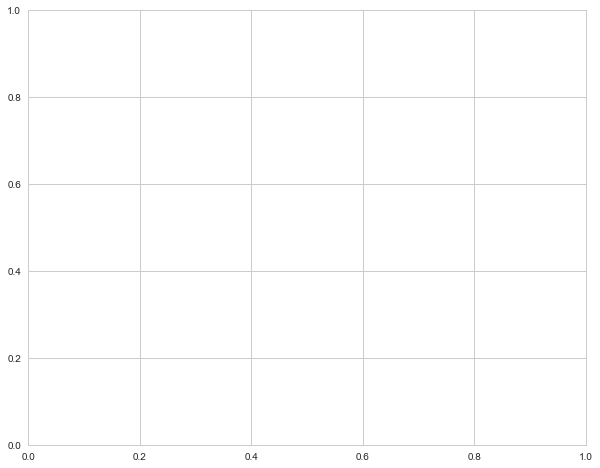

In [16]:
sns.set(style="whitegrid")
fig, axs = plt.subplots(figsize=(10,8))
ax = sns.regplot(data=win_trace_50_samples.reset_index(), x='index', y='bot1', color='b')
ax.set(xlabel='Epochs', ylabel='bot1_wins')
plt.show()

NameError: name 'win_trace_50_samples' is not defined

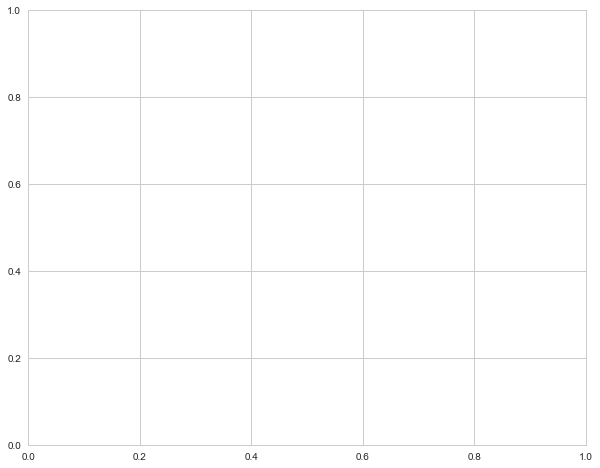

In [17]:
sns.set(style="whitegrid")
fig, axs = plt.subplots(figsize=(10,8))
ax = sns.regplot(data=win_trace_50_samples.reset_index(), x='index', y='bot2', color='g')
ax.set(xlabel='Epochs', ylabel='bot2_wins')
plt.show()